# Generate Crops

## Generate Crops with Mask2Former

In [1]:
# ! pip install -U transformers huggingface-hub torchvision
# ! pip install clip-by-openai
# ! pip install inferno-pytorch
# ! pip install torch==1.10.2

data_path = "/Users/vlad/Downloads/CamVid"

In [2]:
import torch
import numpy as np
from PIL import Image
from torchvision import transforms
import transformers
from transformers import AutoImageProcessor, Mask2FormerForUniversalSegmentation
from matplotlib import pyplot as plt

import os
import torch.utils.data as data
import numpy as np
from PIL import Image
from torchvision.datasets.folder import default_loader
from inferno.utils.exceptions import assert_
from inferno.io.transform.base import Compose
from inferno.io.transform.generic import Normalize, NormalizeRange, Cast, AsTorchBatch, Label2OneHot
from inferno.io.transform.image import \
    RandomSizedCrop, RandomGammaCorrection, RandomFlip, Scale, PILImage2NumPyArray
from matplotlib import pyplot as plt
from torchvision.datasets.folder import is_image_file
from torchvision.datasets.folder import IMG_EXTENSIONS, has_file_allowed_extension
from pathlib import Path

In [3]:
processor_segm = AutoImageProcessor.from_pretrained("facebook/mask2former-swin-base-coco-panoptic")
model_segm = Mask2FormerForUniversalSegmentation.from_pretrained("facebook/mask2former-swin-base-coco-panoptic")
to_tensor = transforms.ToTensor()
to_image = transforms.ToPILImage()

In [4]:
def local_crops_2(image):
  # tensorize the image

    img_tensor = to_tensor(image)

  # preprocess the image for the model
    inputs = processor_segm(image, return_tensors="pt")

  # Apply the model and get the masks prediction
    with torch.no_grad():
        outputs = model_segm(**inputs)
    prediction = processor_segm.post_process_instance_segmentation(outputs, target_sizes=[image.size[::-1]])[0]
    output_tensor = prediction['segmentation'] 

    crops = []
    bboxs = []
    crops_unmasked = []
    masks = []
    count_box_tensor = torch.zeros(output_tensor.shape)
    for i in range(int(torch.max(output_tensor) + 1)):
    # find the mask in the output_tensor
        if not (output_tensor == i).any().item():
            continue
        mask = torch.zeros(output_tensor.shape)
        mask[output_tensor == i] = 1
    # Apply the mask to the image
        masked_img_tensor = img_tensor*mask.expand(3, -1, -1)

    # Compute the bounding box of the non-zero pixels in the masked image
        nonzero_indices = torch.nonzero(masked_img_tensor.sum(dim=0))
        x_min, y_min = nonzero_indices.min(dim=0)[0]
        x_max, y_max = nonzero_indices.max(dim=0)[0]
        bbox = (int(y_min), int(x_min), int(y_max), int(x_max))
    
    # Crop the unmasked part of the image and
        if np.array(to_image(masked_img_tensor).crop(bbox).size).all():
            masked_img = to_image(masked_img_tensor)
            crops+= [masked_img.crop(bbox)]
            crops_unmasked += [image.crop(bbox)]
            bboxs +=[bbox]
            masks += [mask]
        
        count_box_tensor[bbox[1]:bbox[3], bbox[0]:bbox[2]] +=1.

    return crops,crops_unmasked, bboxs, count_box_tensor, masks

## Display & test

In [5]:
def display_img_list(crops):
  # Compute the dimensions of the new image to display the images in
    total_width = max(img.width for img in crops)
    max_height = sum(img.height for img in crops)
    display_img = Image.new("RGB", (total_width, max_height))

  # Paste each image onto the new image
    y_offset = 0
    for img in crops:
        display_img.paste(img, (0, y_offset))
        y_offset += img.height
    return display_img
def display_tensor_list(crops):
  # Compute the dimensions of the new image to display the images in
    total_width = max(to_image(img).width for img in crops)
    max_height = sum(to_image(img).height for img in crops)
    display_img = Image.new("RGB", (total_width, max_height))

  # Paste each image onto the new image
    y_offset = 0
    for img in crops:
        display_img.paste(to_image(img), (0, y_offset))
        y_offset += to_image(img).height
    return display_img

In [6]:
#!ln -s /System/Applications/Preview.app /Applications/Preview.app
image = Image.open("4.jpg")
crops,crops_unmasked, bboxs,count_box_tensor, masks = local_crops_2(image)

/Users/vlad/opt/anaconda3/lib/python3.9/site-packages/transformers/models/mask2former/image_processing_mask2former.py:1010: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  topk_indices = topk_indices // num_classes


tensor(8.)


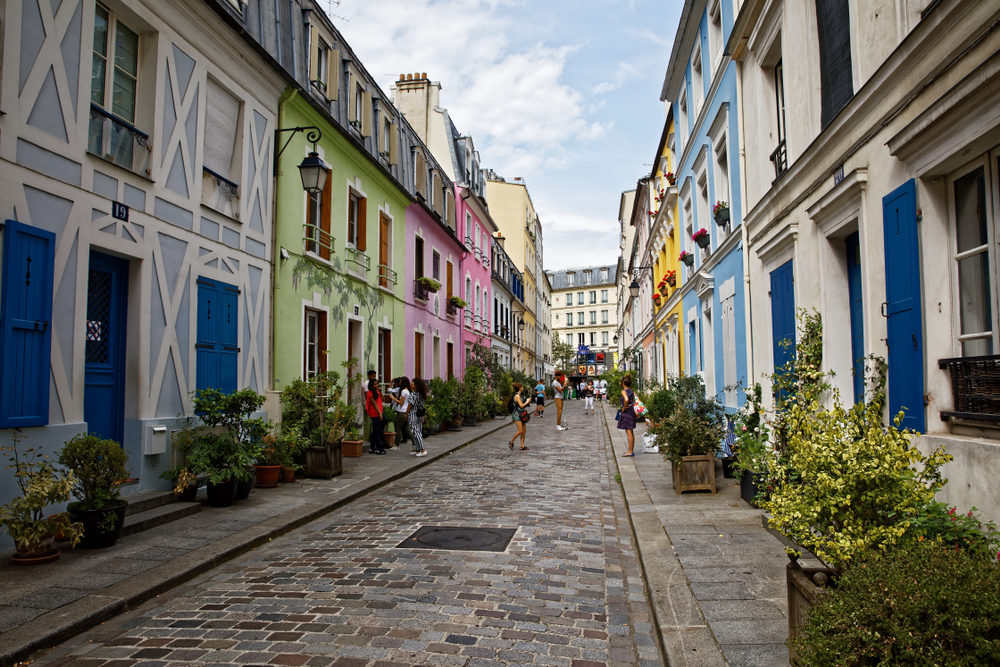

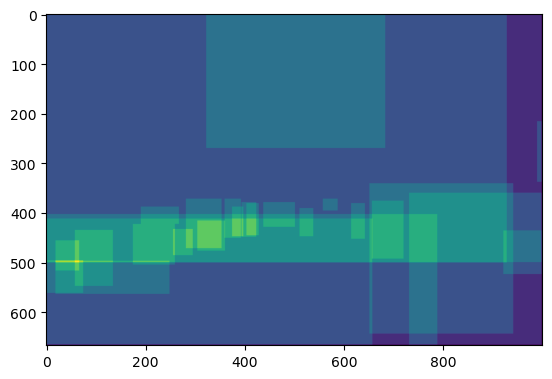

In [7]:
print(count_box_tensor.max())
plt.imshow(count_box_tensor)
image

27


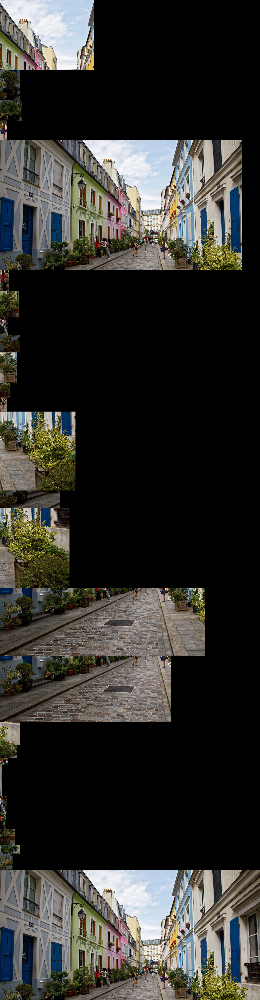

In [8]:
print(len(crops))
display_img_list(crops_unmasked)

## CamVid

In [9]:
def is_image_file(filename):
    return has_file_allowed_extension(filename, IMG_EXTENSIONS)

CAMVID_CLASSES = ['Sky',
'Building',
'Column-Pole',
'Road',
'Sidewalk',
'Tree',
'Sign-Symbol',
'Fence',
'Car',
'Pedestrain',
'Bicyclist',
'Void']


# weights when using median frequency balancing used in SegNet paper
# https://arxiv.org/pdf/1511.00561.pdf
# The numbers were generated by:
# https://github.com/yandex/segnet-torch/blob/master/datasets/camvid-gen.lua
CAMVID_CLASS_WEIGHTS = [0.58872014284134,
                        0.51052379608154,
                        2.6966278553009,
                        0.45021694898605,
                        1.1785038709641,
                        0.77028578519821,
                        2.4782588481903,
                        2.5273461341858,
                        1.0122526884079,
                        3.2375309467316,
                        4.1312313079834,
                        0]
# mean and std
CAMVID_MEAN = [0.41189489566336, 0.4251328133025, 0.4326707089857]
CAMVID_STD = [0.27413549931506, 0.28506257482912, 0.28284674400252]

CAMVID_CLASS_COLORS = [
    (128, 128, 128),
    (128, 0, 0),
    (192, 192, 128),
    (128, 64, 128),
    (0, 0, 192),
    (128, 128, 0),
    (192, 128, 128),
    (64, 64, 128),
    (64, 0, 128),
    (64, 64, 0),
    (0, 128, 192),
    (0, 0, 0),
]

def make_dataset(dir):
    images = []
    for root, _, fnames in sorted(os.walk(dir)):
        for fname in fnames:
            if is_image_file(fname):
                path = os.path.join(root, fname)
                item = path
                images.append(item)
    return images



def label_to_long_tensor(pic):
    label = torch.ByteTensor(torch.ByteStorage.from_buffer(pic.tobytes()))
    label = label.view(pic.size[1], pic.size[0], 1)
    label = label.transpose(0, 1).transpose(0, 2).squeeze().contiguous().long()
    return label



def label_to_pil_image(label):
    label = label.unsqueeze(0)
    colored_label = torch.zeros(3, label.size(1), label.size(2)).byte()
    for i, color in enumerate(CAMVID_CLASS_COLORS):
        mask = label.eq(i)
        for j in range(3):
            colored_label[j].masked_fill_(mask, color[j])
    npimg = colored_label.numpy()
    npimg = np.transpose(npimg, (1, 2, 0))
    mode = None
    if npimg.shape[2] == 1:
        npimg = npimg[:, :, 0]
        mode = "L"

    return Image.fromarray(npimg, mode=mode)



class CamVid(data.Dataset):
    SPLIT_NAME_MAPPING = {'train': 'train',
                          'training': 'train',
                          'validate': 'val',
                          'val': 'val',
                          'validation': 'val',
                          'test': 'test',
                          'testing': 'test'}
    # Dataset statistics
    CLASS_WEIGHTS = CAMVID_CLASS_WEIGHTS
    CLASSES = CAMVID_CLASSES
    MEAN = CAMVID_MEAN
    STD = CAMVID_STD

    def __init__(self, root, split='train',
                 image_transform=None, label_transform=None, joint_transform=None,
                 download=False, loader=default_loader, raw_image_transform = None):
        # Validate
        assert_(split in self.SPLIT_NAME_MAPPING.keys(),
                "`split` must be one of {}".format(set(self.SPLIT_NAME_MAPPING.keys())),
                KeyError)
        # Root directory and split
        self.root_directory = root
        self.split = self.SPLIT_NAME_MAPPING.get(split)
        # Utils
        self.image_loader = loader
        # Transforms
        self.image_transform = image_transform
        self.raw_image_transform = raw_image_transform
        self.label_transform = label_transform
        self.joint_transform = joint_transform
        # For when we implement download:
        if download:
            self.download()
        # Make dataset with paths to the image
        self.image_paths = make_dataset(os.path.join(self.root_directory, self.split))
        
    def __getitem__(self, index):
        path = self.image_paths[index]
        image = self.image_loader(path)

        label = Image.open(path.replace(self.split, self.split + 'annot'))
        # Apply transforms
        if self.raw_image_transform is not None:
            raw_image = self.raw_image_transform(image)
        if self.image_transform is not None:
            image = self.image_transform(image)
        
        if self.label_transform is not None:
            label = self.label_transform(label)
        if self.joint_transform is not None:
            image, label = self.joint_transform(image, label)
        
        #get boxes
        crops,crops_unmasked, bboxs, count_box_tensor, masks = local_crops_2(raw_image)
        crops_preprocessed = []
        
        for crop in crops:
            crops_preprocessed+= [self.image_transform(crop)]
            
                
        return image, crops_preprocessed, label, bboxs, count_box_tensor, raw_image, masks
    
    def get_gt(self, index):
        image_path = Path(self.image_paths[index])
        label_path = image_path.parent.parent/'labels'/(image_path.name[:-4]+'_L'+'.png')
        label = Image.open(label_path)
        image = Image.open(image_path)
        
        
        return label
        
    def __len__(self):
        return len(self.image_paths)

    def download(self):
        # TODO: please download the dataset from
        # https://github.com/alexgkendall/SegNet-Tutorial/tree/master/CamVid
        raise NotImplementedError
     
    
    

def denormalize_image(image: torch.Tensor) -> torch.Tensor:
    image_mean = torch.tensor([0.48145466, 0.4578275, 0.40821073]).to('cpu')
    image_std = torch.tensor([0.26862954, 0.26130258, 0.27577711]).to('cpu')
    image *= image_std[:, None, None]    
    image += image_mean[:, None, None]
    return image

def show_crop_preprocessed(dataset, _id = 0, number_of_crops = 16):
    plt.figure(figsize=(10, 10))
    number_of_crops = min(len(dataset[_id][1]), number_of_crops)
    d_sub = torch.utils.data.Subset(dataset[_id][1], np.random.choice(len(dataset[_id][1]), number_of_crops, replace=False))
    # Show all images from the dataset since our dataset is small
    for idx, crop in enumerate(d_sub):

        plt.subplot(4, 4, idx+1)
        plt.imshow(denormalize_image(crop).permute(1, 2, 0))
        plt.title(f"{idx}")
        plt.xticks([])
        plt.yticks([])

    plt.tight_layout()
    plt.show()
    
    
def list_to_tensor(l):
    size = (len(l),)+tuple(list(l[0].size()))
    b = torch.Tensor(*size)
    b = torch.stack(l)
    return b

def get_features_for_one_image_and_its_clips(dataset, _id, model):
    inputs = dataset[_id]
    image, crops_preprocessed, label, bboxs, count_box_tensor, raw_image, masks = inputs
    crops_inputs = list_to_tensor(crops_preprocessed)
    
    #for crops
    with torch.no_grad():
        crops_features = model.encode_image(crops_inputs)
        image = image.unsqueeze(0).to(device)
        image_features = model.encode_image(image)
    
    
    return image_features, crops_features, bboxs, count_box_tensor, masks


def pixelwise_embedding(comined_features, bboxs, count_box_tensor):
    size = tuple(count_box_tensor.size())+ (comined_features[0].size()[0],)
    count_box_tensors = count_box_tensor.unsqueeze(2).repeat(1,1, comined_features[0].size()[0])
    pixelwise_embedding = torch.zeros(size)
    for idx, bbox in enumerate(bboxs):
        pixelwise_embedding[bbox[1]:bbox[3], bbox[0]:bbox[2], :] += comined_features[idx]
        
    return pixelwise_embedding/count_box_tensors

def pixelwise_embedding_masked(comined_features, crop_masks, count_box_tensor):
    size = tuple(count_box_tensor.size())+ (comined_features[0].size()[0],)
    count_box_tensors = count_box_tensor.unsqueeze(2).repeat(1,1, comined_features[0].size()[0])
    pixelwise_embedding = torch.zeros(size)
    
    for idx, mask in enumerate(crop_masks):
        pixelwise_embedding[mask > 0] += comined_features[idx]
        
    return pixelwise_embedding


def get_segmentation_mask(image_features, model, class_names):
    """
    image_features: torch.Tensor of size (n_samples, H, W, emb_dim)
    """
    # getting text tokens
    class_captions = [f"An image depicting a {x}" for x in class_names]
    text_input = clip.tokenize(class_captions).to(device)
    with torch.no_grad():
        text_features = model.encode_text(text_input).float()
        text_features /= text_features.norm(dim=-1, keepdim=True)
    
    text_probs = (image_features @ text_features.T).softmax(dim=-1)
    masks = torch.argmax(text_probs, dim=-1)
    return masks

def feature_fusion(f_local, f_global, tau=1, epsilon=1e-6):
    """
    Performs feature Fusion described in https://concept-fusion.github.io/assets/pdf/2023-ConceptFusion.pdf
    
    local_features: Torch.Tensor of size (R, emb_dim)
    global_feature: Torch.Tensor of size (1, emb_dim)
    
    """
    f_global = f_global.view(-1)
    def cosine_similarity(f1, f2, epsilon=epsilon):
        f1 = f1.to(torch.float32)
        f2 = f2.to(torch.float32)
        return torch.dot(f1, f2)/(torch.linalg.norm(f1)*torch.linalg.norm(f2) + epsilon)
    
    R = f_local.size()[0]
    
    psi = torch.tensor([cosine_similarity(f, f_global) for f in f_local])
    phi_matrix = [[cosine_similarity(f1, f2) for f2 in f_local] for f1 in f_local]
    phi = torch.tensor([(np.sum(phi_row) - phi_matrix[i][i])/R for i, phi_row in enumerate(phi_matrix)])
    
    _exp = torch.exp((psi+phi)/tau)
    w = _exp/torch.sum(_exp)
    
    return ((1-w)*f_local.T).T + w[..., None]*f_global


color_map = {i: color for i, color in enumerate(CAMVID_CLASS_COLORS)}

COLORS_PLOT = [
    '#BFEFFF',
    '#0343DF',
    '#653700',
    '#15B01A',
    '#E50000',
    '#7E1E9C',
    '#F97306',
    '#FF81C0',
    '#AAFF32',
    '#6E750E',
    '#00FFFF',
    '#FFFF14',
]

def hex2rgb(h):
    """
    Convert hex code #bla-bla-bla to rgb tuple
    """
    h = h[1:]
    return tuple(int(h[i:i+2], 16) for i in (0, 2, 4))
 

def seg_mask2tesor_image(segm_mask):
    segm_mask[0].size()
    size = (3,)+tuple(segm_mask[0].size())
    tensor_image = torch.zeros(size)
    for i in range(size[1]):
        for j in range(size[2]):
            #print(segm_mask[0][i][j].item())
            tensor_image[:,i,j] = torch.Tensor(hex2rgb(
                COLORS_PLOT[segm_mask[0][i][j].item()]
            ))
    
    fig, ax = plt.subplots(1, 1, figsize = (30, 10))
    ax.imshow(tensor_image.int().permute(1, 2, 0))
    [ax.scatter([], [], c=COLORS_PLOT[i], label=label) for i, label in enumerate(CAMVID_CLASSES)]
    ax.legend(loc='upper right')
    
    
def gt_plot(gt):
    size = (3,)+tuple(gt.shape)
    tensor_image = torch.zeros(size)
    for i in range(size[1]):
        for j in range(size[2]):
            tensor_image[:,i,j] = torch.Tensor(hex2rgb(
                COLORS_PLOT[gt[i][j]]
            ))
    
    fig, ax = plt.subplots(1, 1, figsize = (30, 10))
    ax.imshow(tensor_image.int().permute(1, 2, 0))
    [ax.scatter([], [], c=COLORS_PLOT[i], label=label) for i, label in enumerate(CAMVID_CLASSES)]
    ax.legend(loc='upper right')

In [13]:
import clip
from torch.utils.data import DataLoader
import cv2

def get_label_tensor(mask):
    mask = np.asarray(mask)
    label_indexed = np.zeros(mask.shape[:2])
    for i, row in enumerate(mask):
        for j, element in enumerate(row):
            if tuple(element) in CAMVID_CLASS_COLORS:
                label_indexed[i, j] = CAMVID_CLASS_COLORS.index(tuple(element))
            else:
                label_indexed[i, j] = 10 # void
    return label_indexed.astype(int)

def predict_segmentation_mask(d, model, _id):    
    show_crop_preprocessed(d, _id = _id)
    image_features, crops_features, bboxs, count_box_tensor, masks = get_features_for_one_image_and_its_clips(d, _id, model)
    feature_fusions = feature_fusion(crops_features, image_features)
    pixelwise_embeddings = pixelwise_embedding(feature_fusions, bboxs, count_box_tensor)

    segm_mask = get_segmentation_mask(pixelwise_embeddings[None, ...], model, CAMVID_CLASSES)
    #show raw image
    fig, ax = plt.subplots(1, 1, figsize = (30, 10))
    ax.imshow(d[_id][-2])
    seg_mask2tesor_image(segm_mask)
    #classes

def predict_segmentation_mask_masked(d, model, _id):    
    print("Showing random chosen crops:")
    show_crop_preprocessed(d, _id = _id)
    image_features, crops_features, bboxs, count_box_tensor, masks = get_features_for_one_image_and_its_clips(d, _id, model)
    feature_fusions = feature_fusion(crops_features, image_features)
    pixelwise_embeddings = pixelwise_embedding_masked(feature_fusions, masks, count_box_tensor)

    segm_mask = get_segmentation_mask(pixelwise_embeddings[None, ...], model, CAMVID_CLASSES)
    #show raw image
    fig, ax = plt.subplots(1, 1, figsize = (30, 10))
    
    print("Image given as an input:")
    ax.imshow(d[_id][-2])
    plt.show()
    
    print("Prediction:")
    seg_mask2tesor_image(segm_mask)
    segm_mask = np.asarray(segm_mask[0])
    plt.show()
    
    print("GT mask: ")
    label = d.get_gt(_id)
    label = get_label_tensor(label)
    label = cv2.resize(label, segm_mask.shape[::-1], 0, 0, interpolation = cv2.INTER_NEAREST)

    gt_plot(label)
    plt.show()
    return label, segm_mask

Processing ID 202...
Showing random chosen crops:


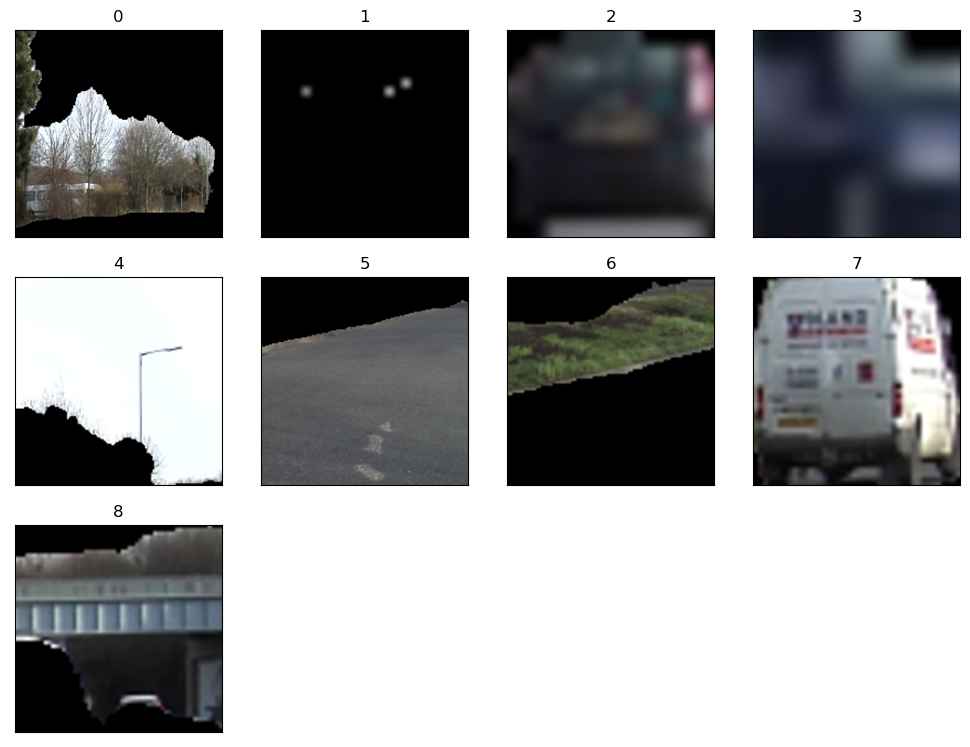

Image given as an input:


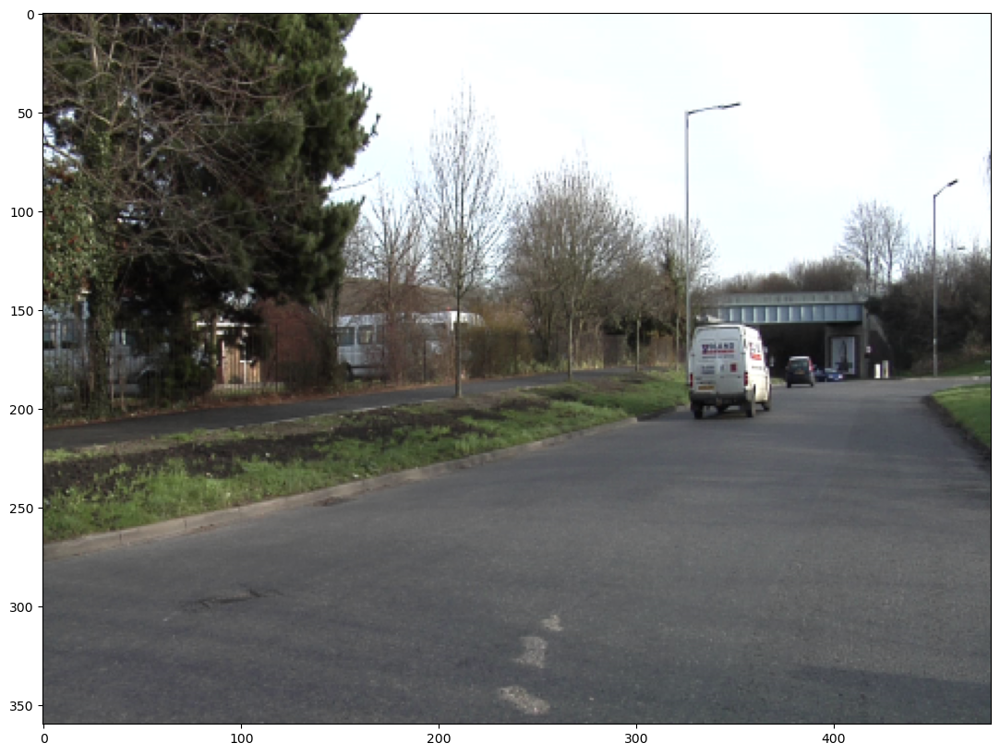

Prediction:


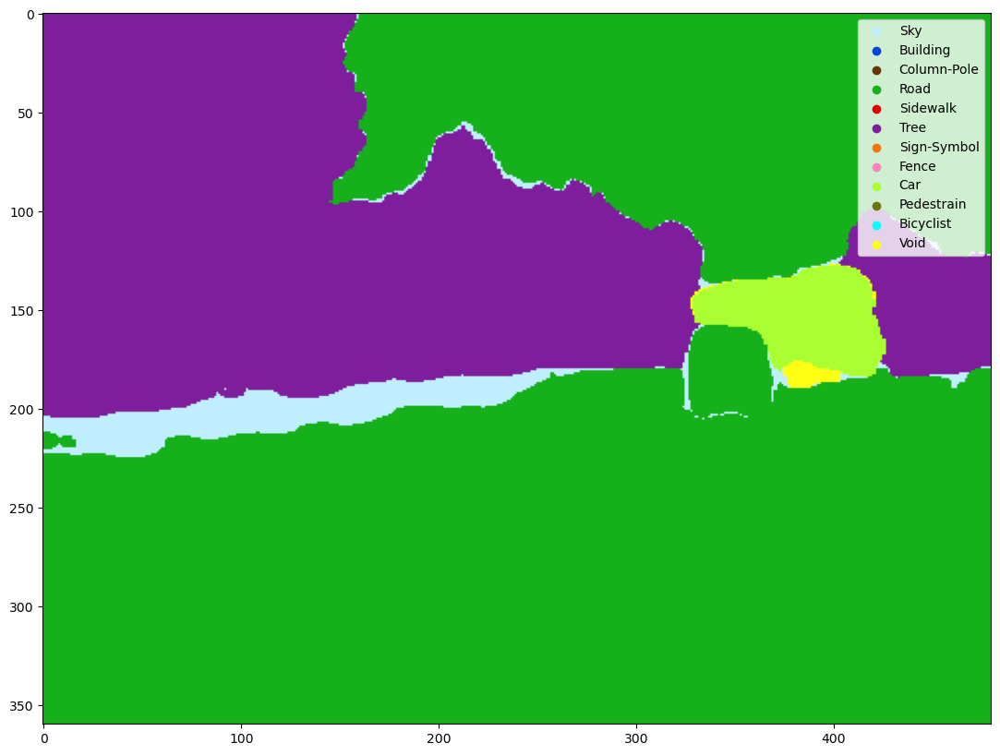

GT mask: 


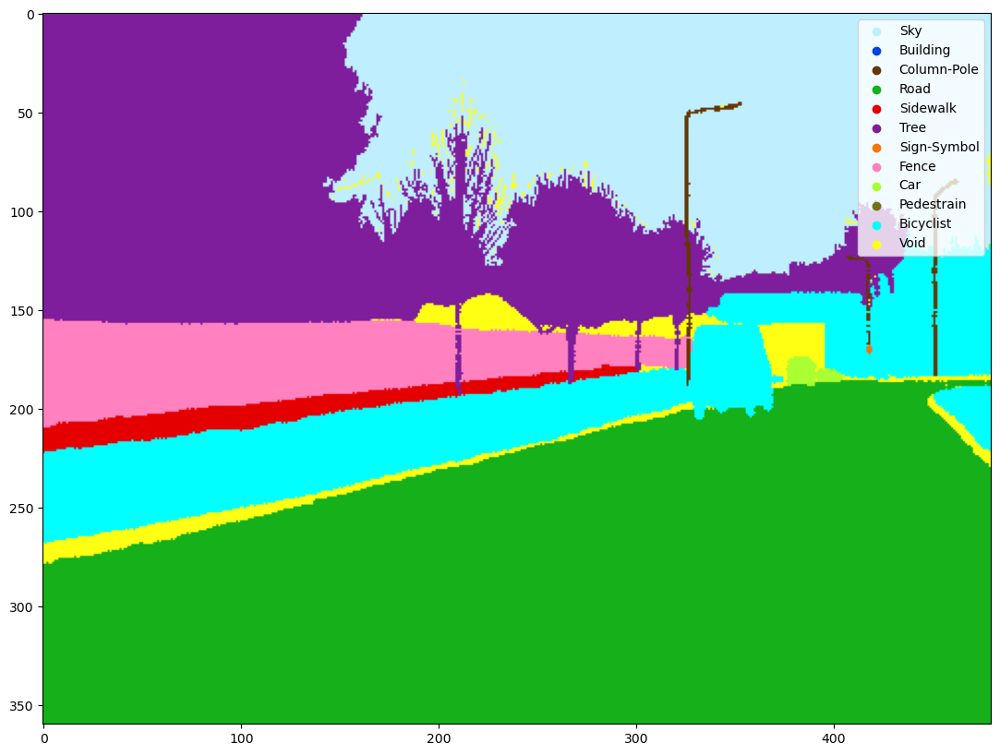

(360, 480) (360, 480)
Processing ID 238...
Showing random chosen crops:


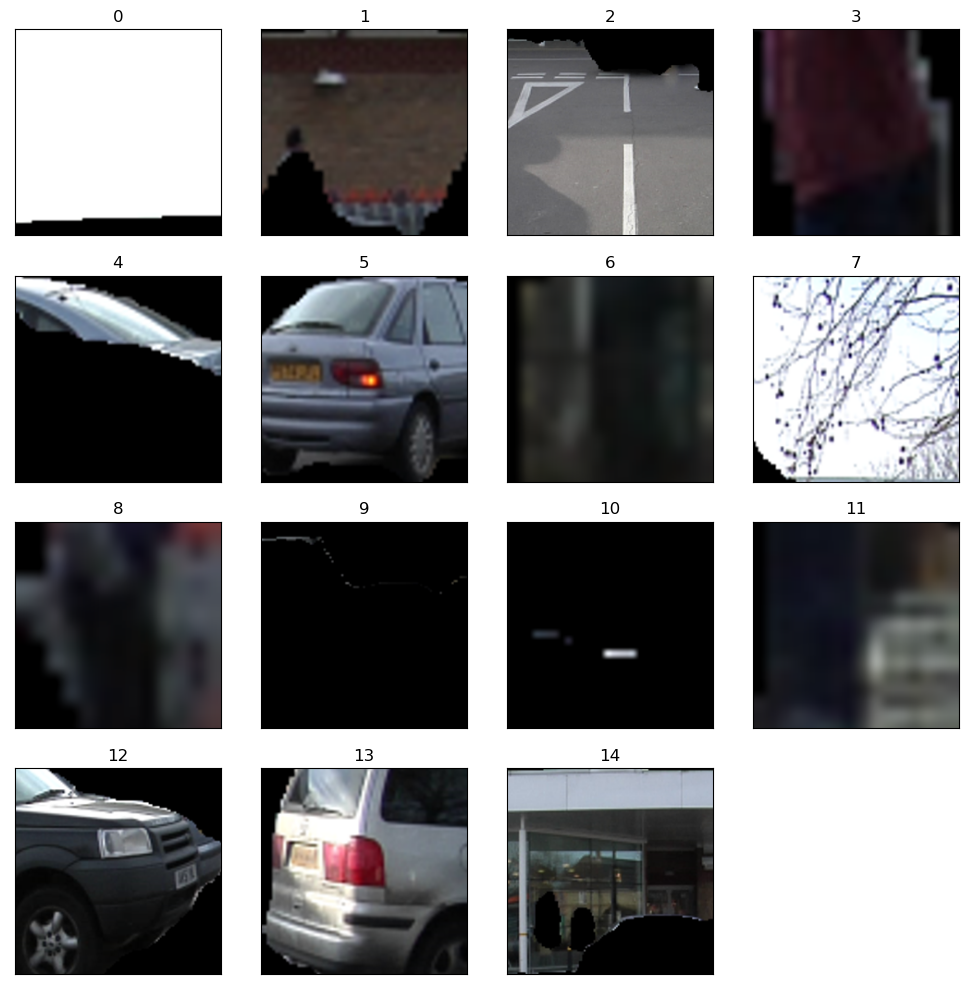

Image given as an input:


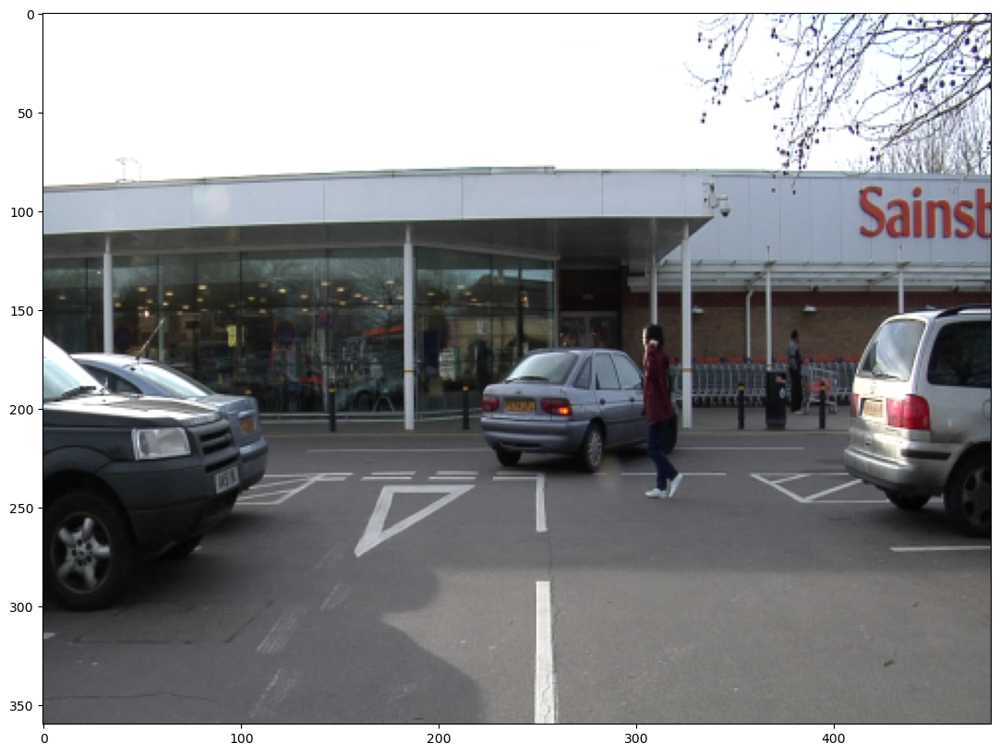

Prediction:


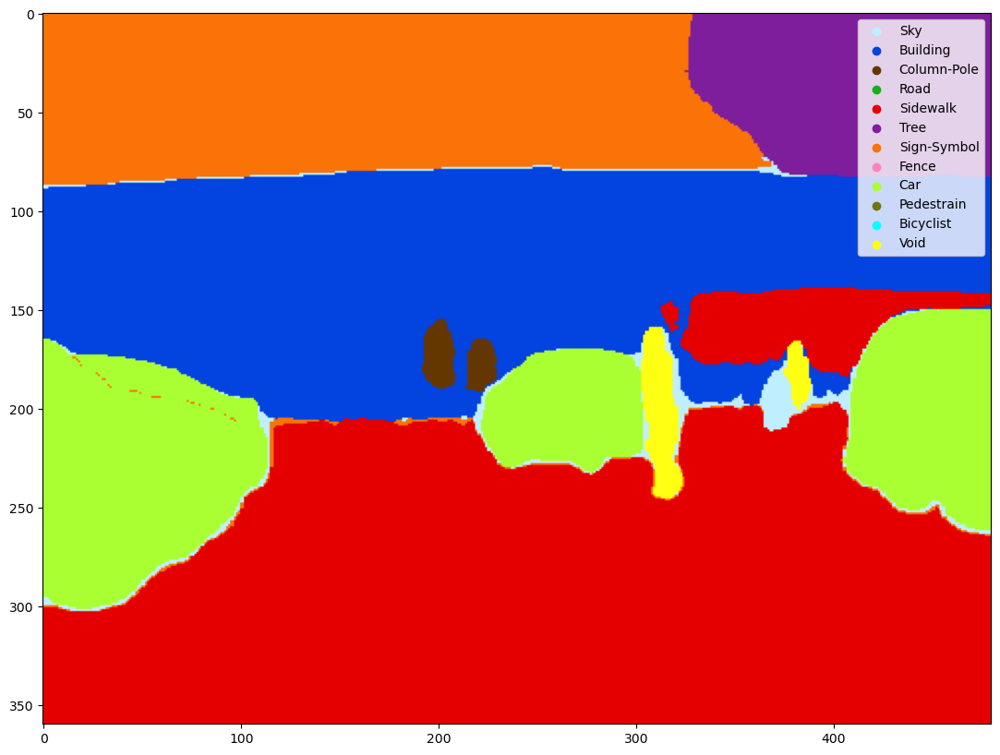

GT mask: 


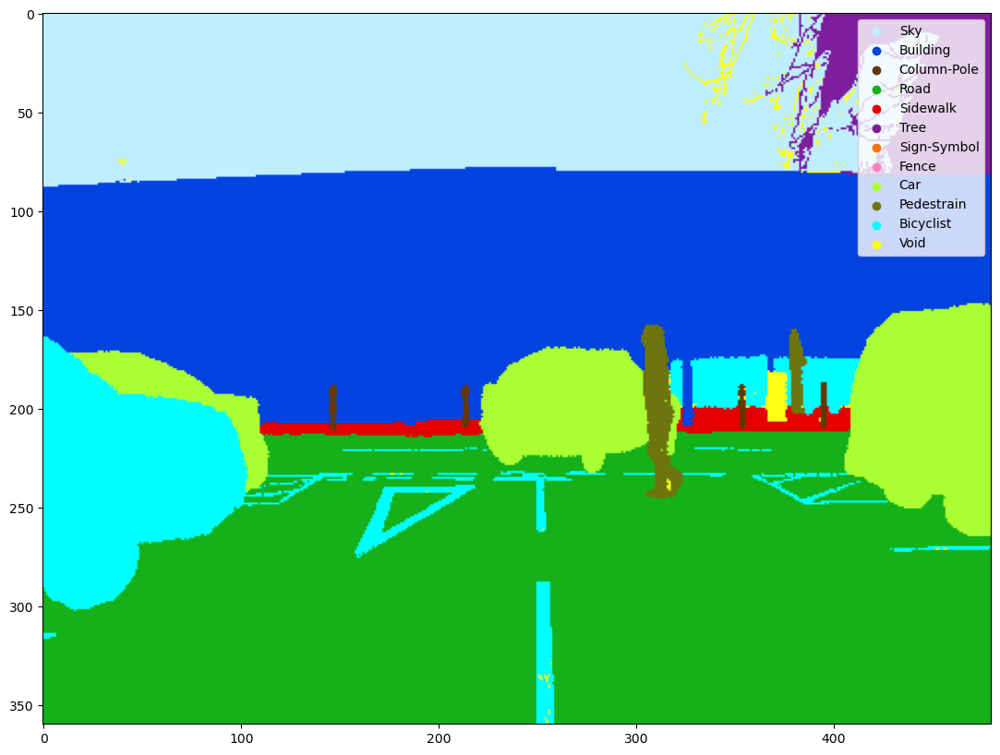

(360, 480) (360, 480)
Processing ID 260...
Showing random chosen crops:


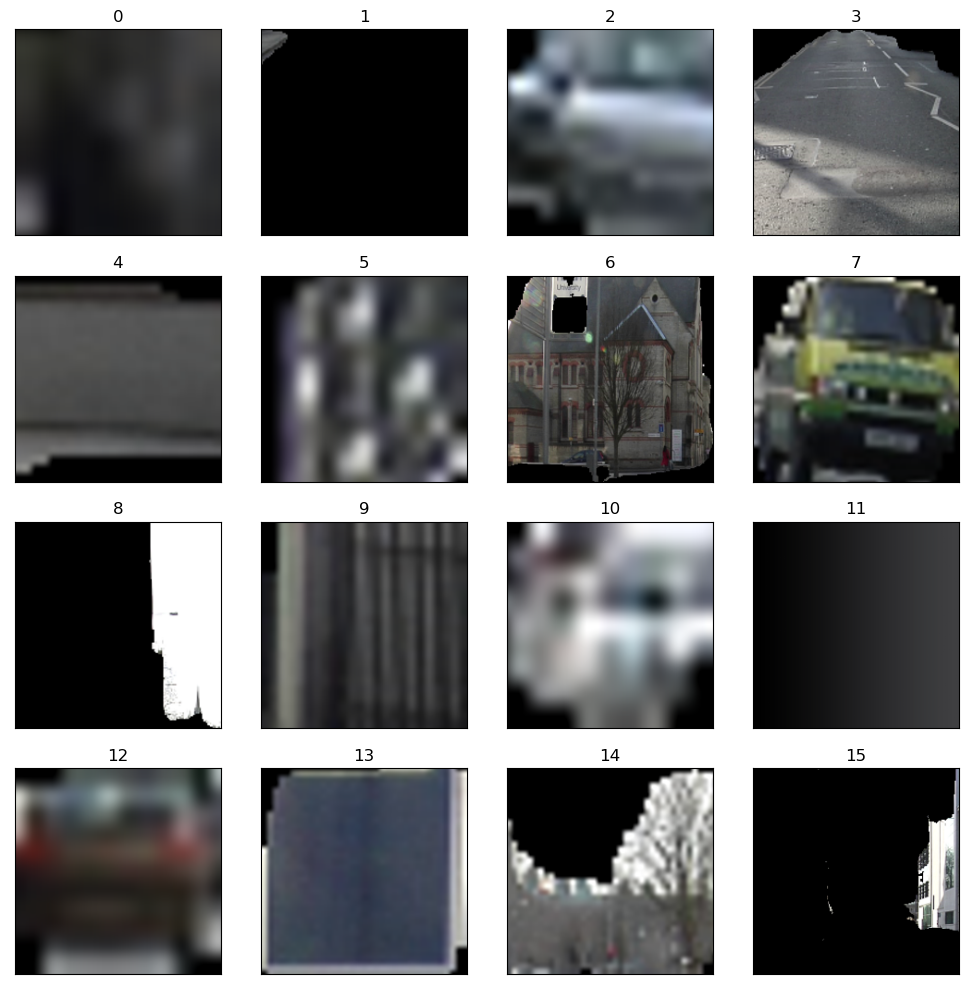

Image given as an input:


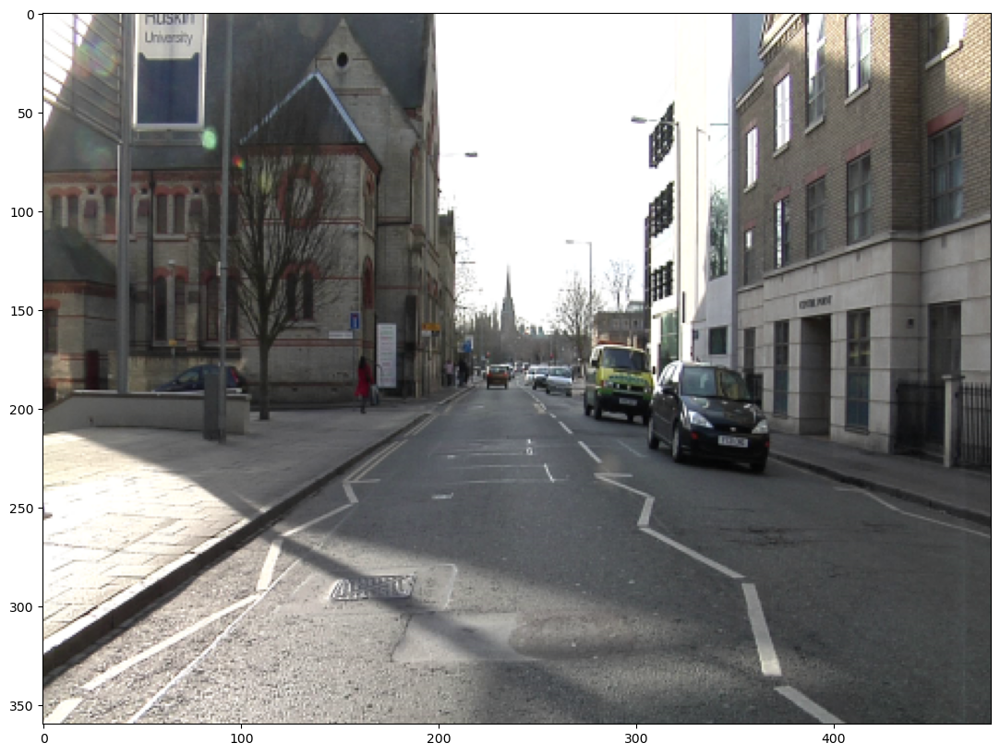

Prediction:


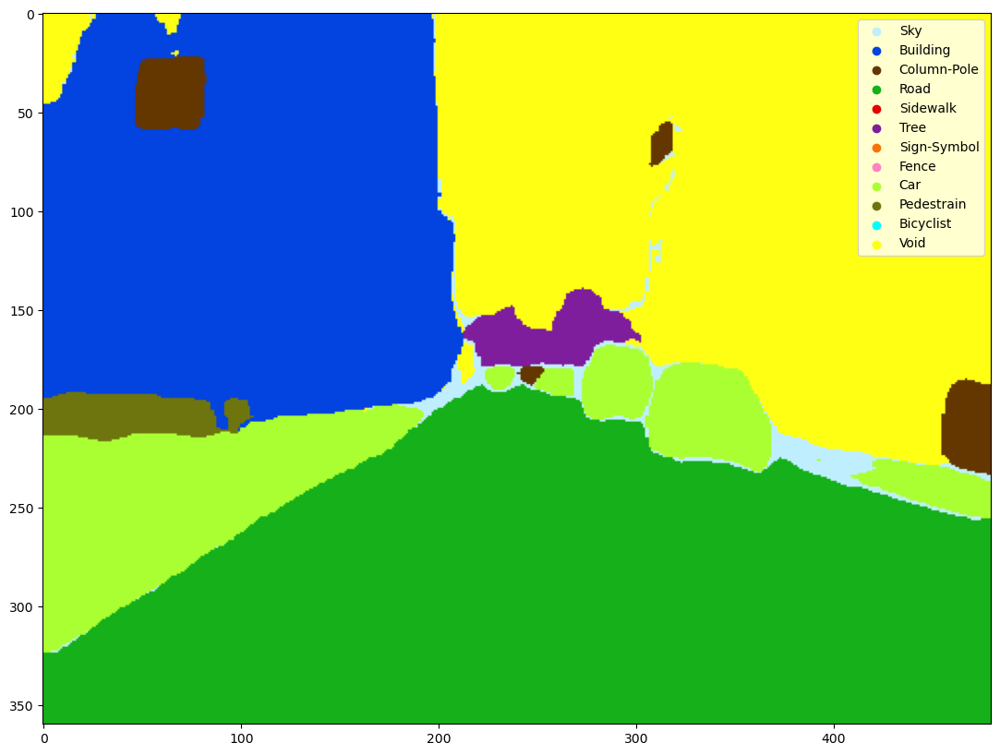

GT mask: 


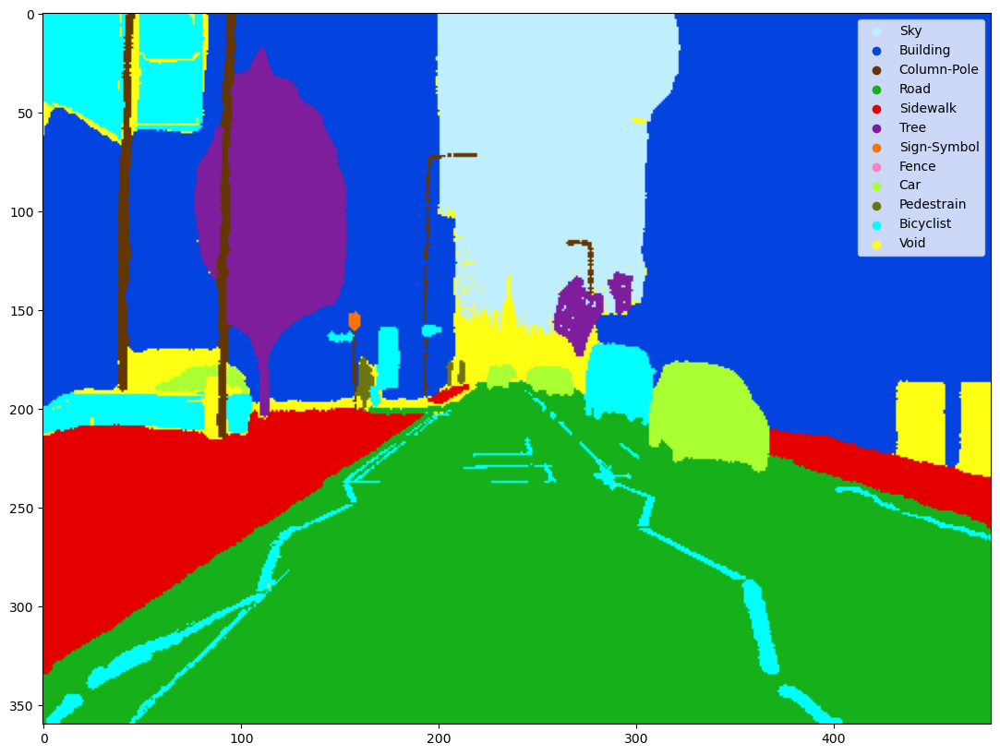

(360, 480) (360, 480)
Processing ID 324...
Showing random chosen crops:


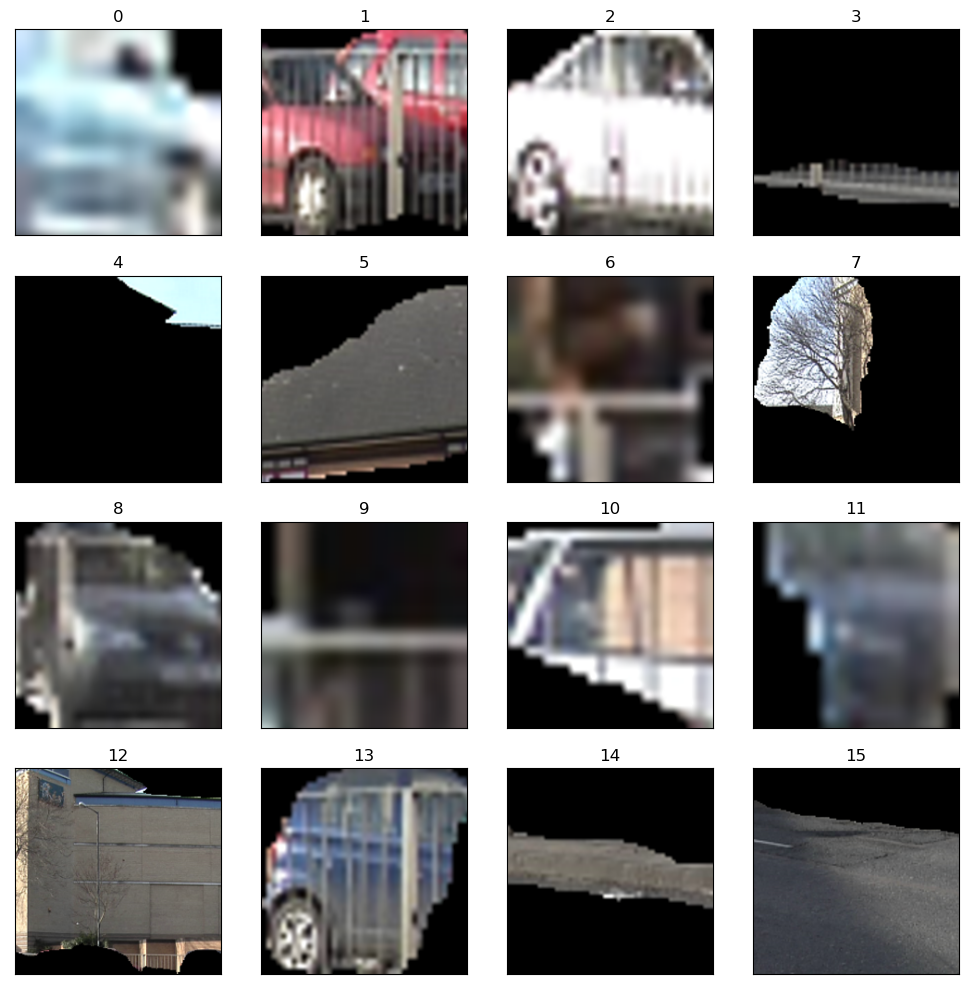

Image given as an input:


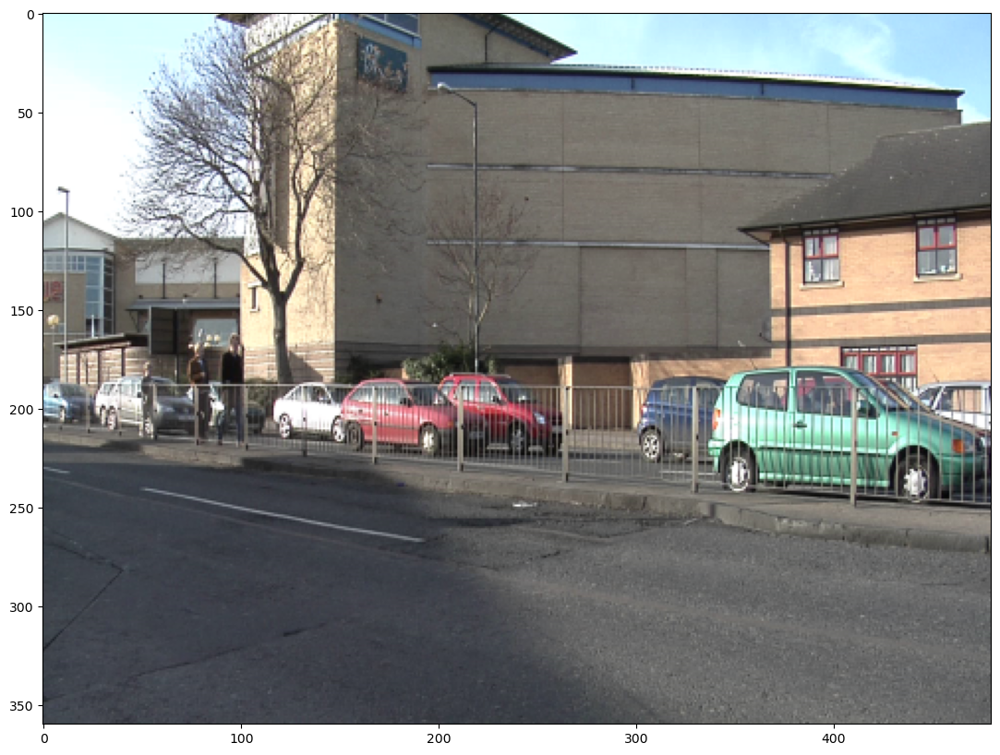

Prediction:


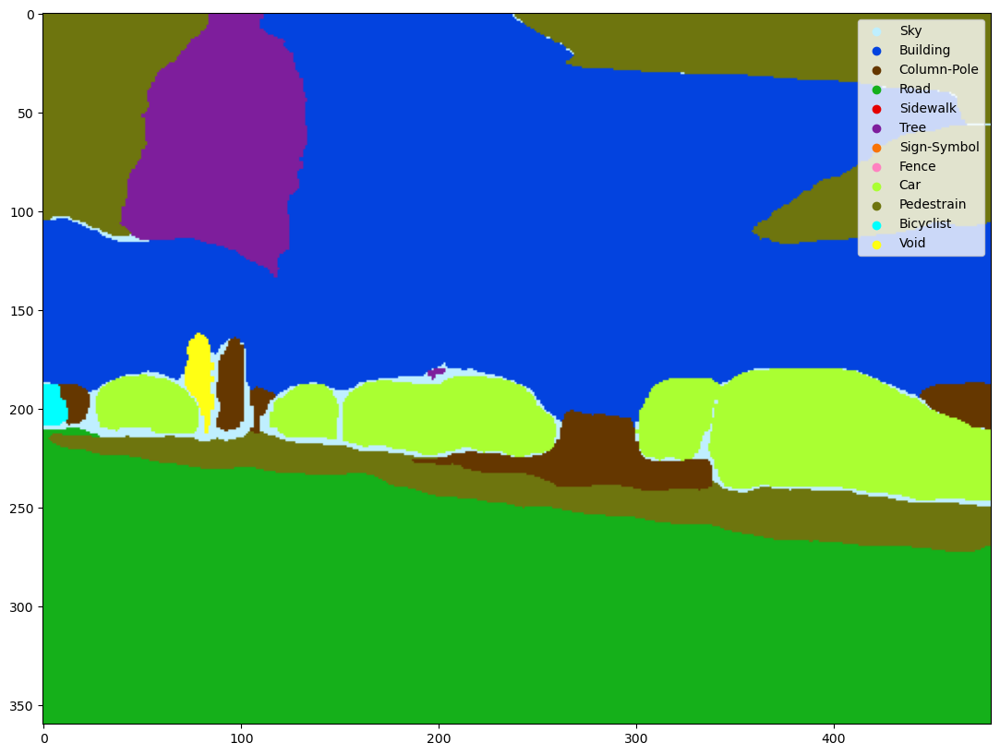

GT mask: 


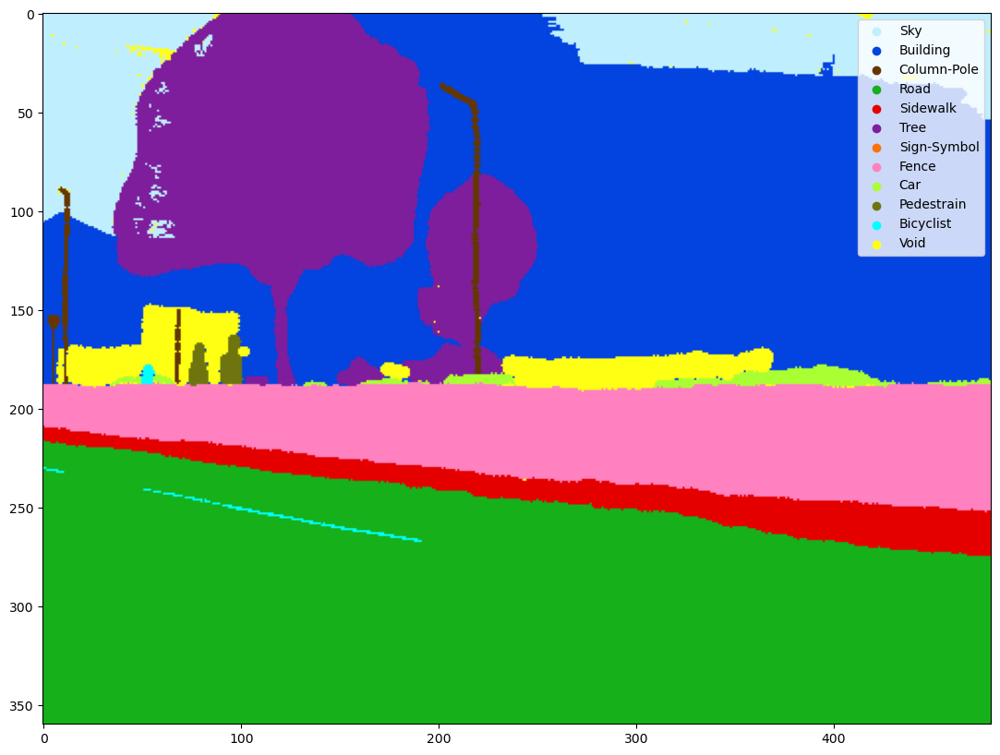

(360, 480) (360, 480)
Processing ID 295...
Showing random chosen crops:


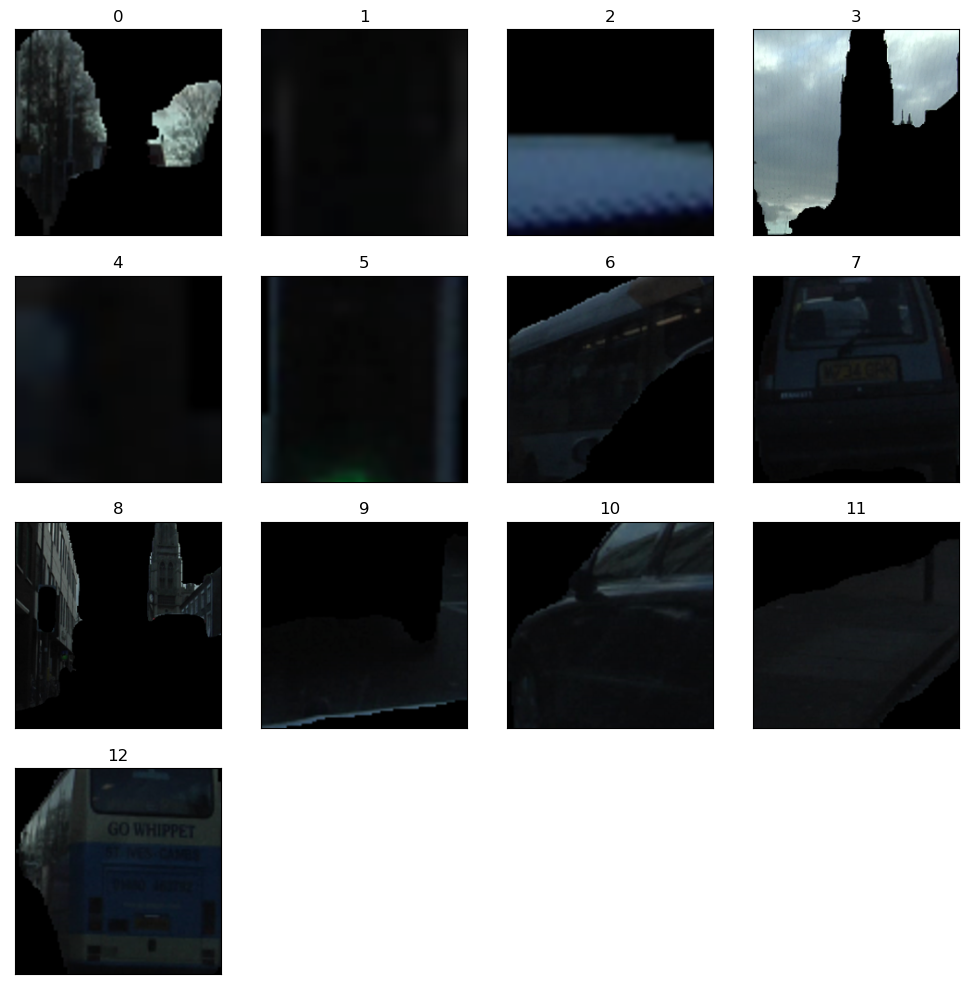

Image given as an input:


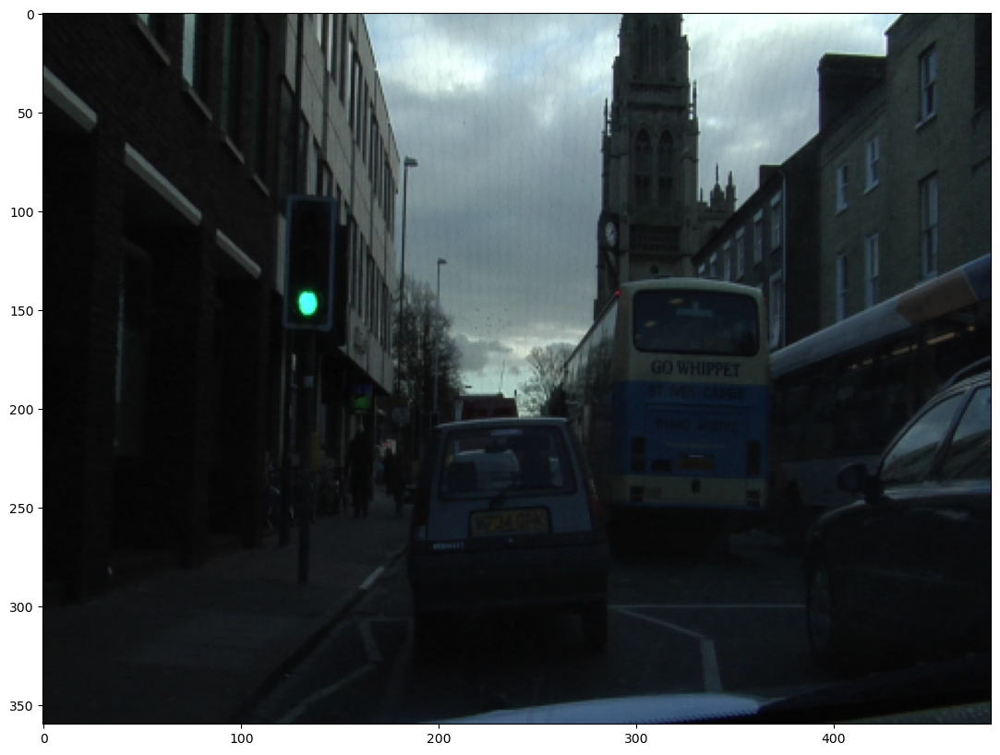

Prediction:


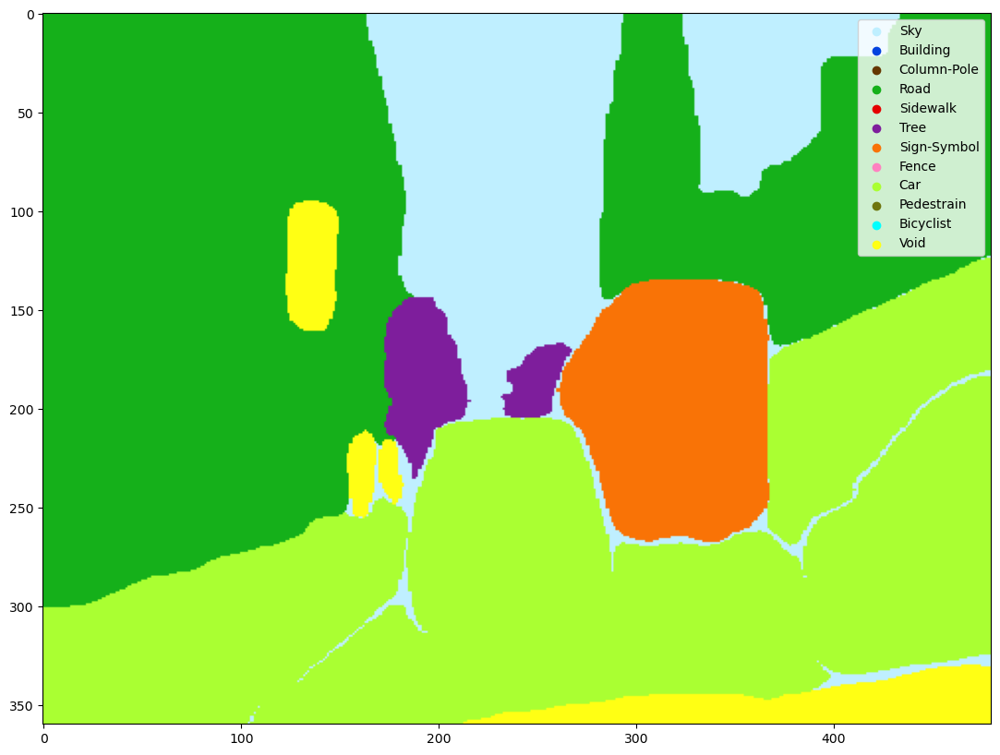

GT mask: 


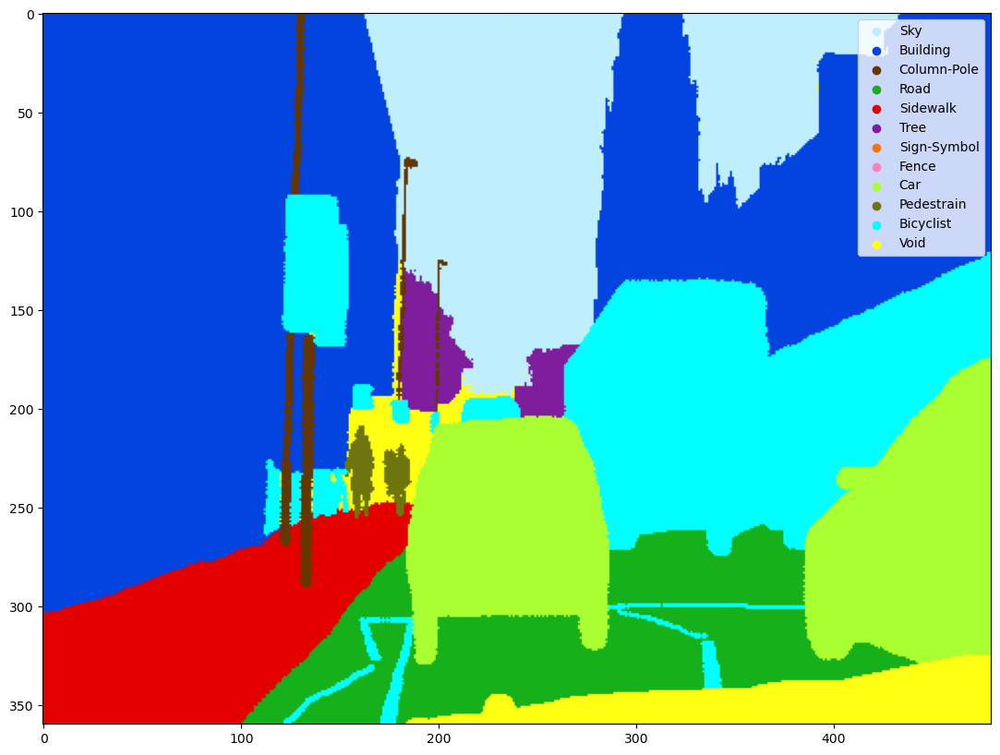

(360, 480) (360, 480)
Processing ID 214...
Showing random chosen crops:


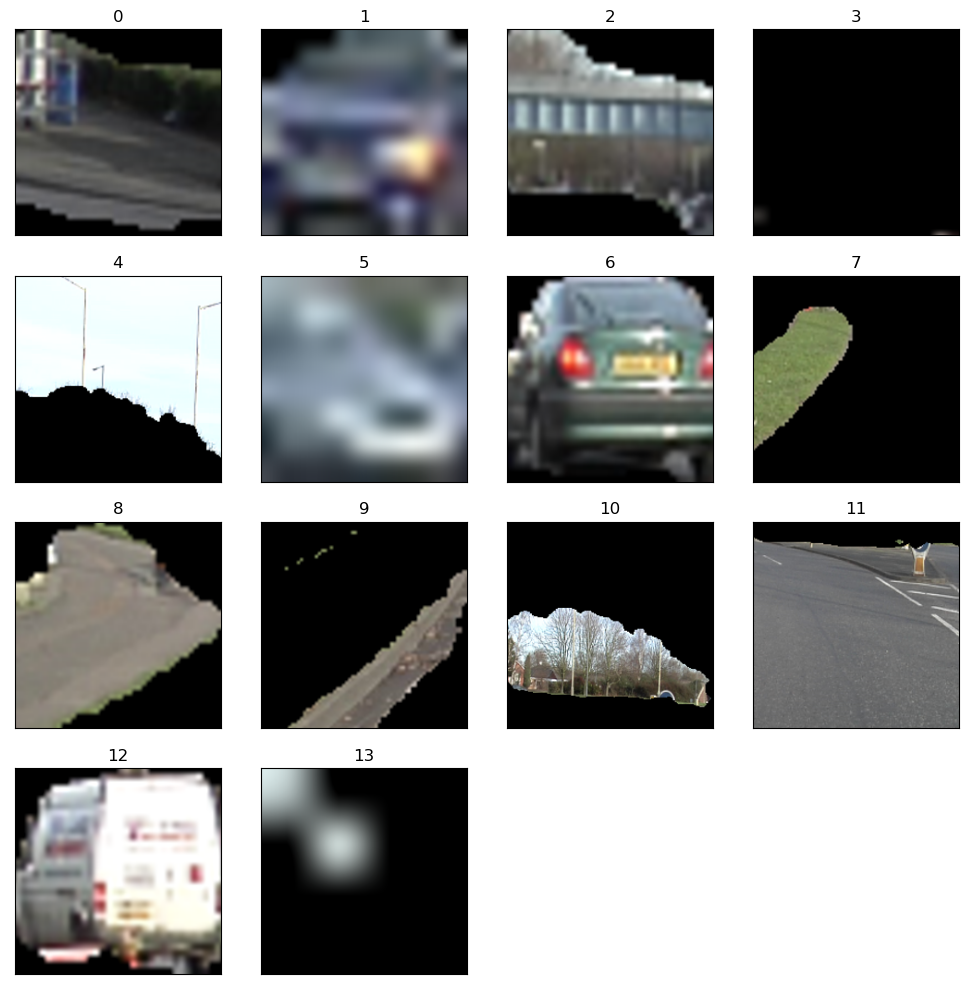

Image given as an input:


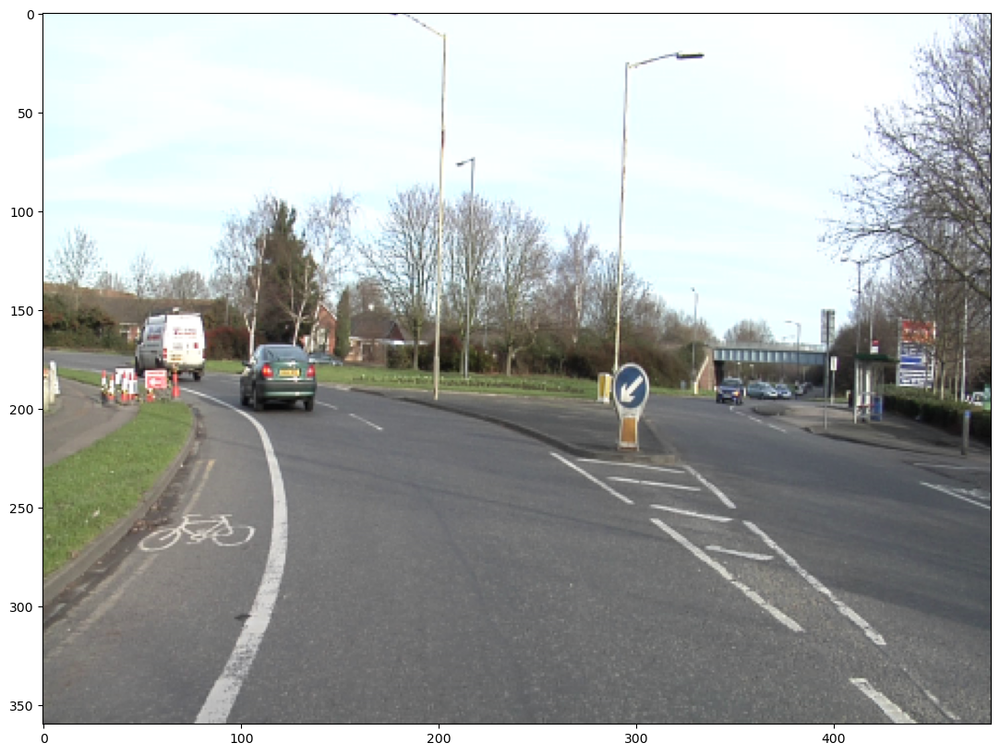

Prediction:


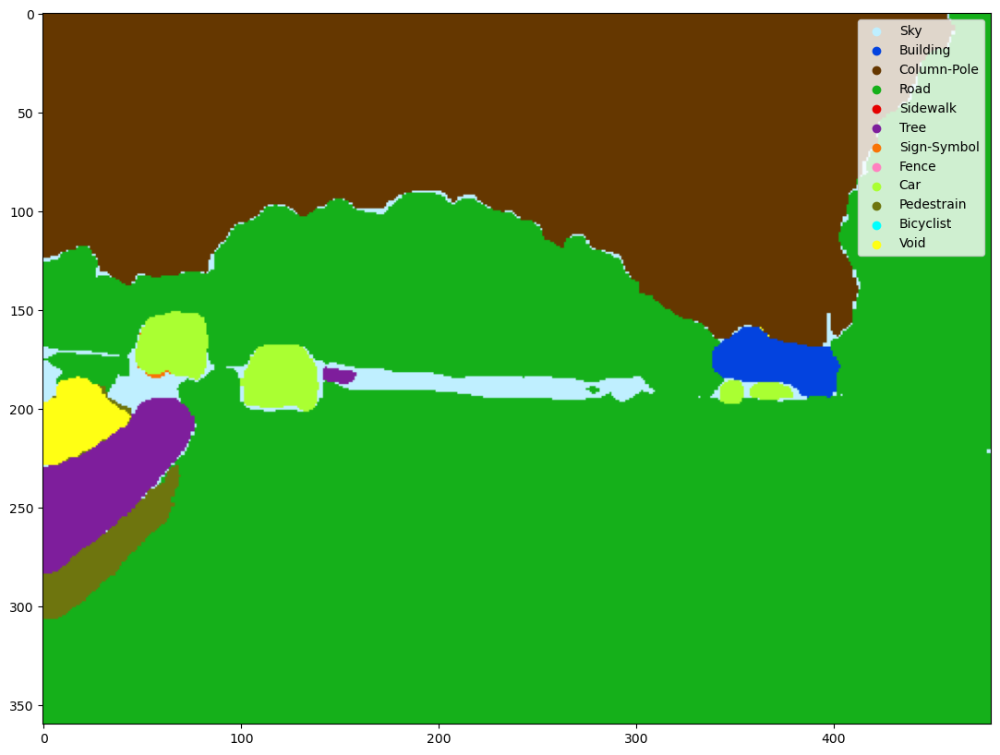

GT mask: 


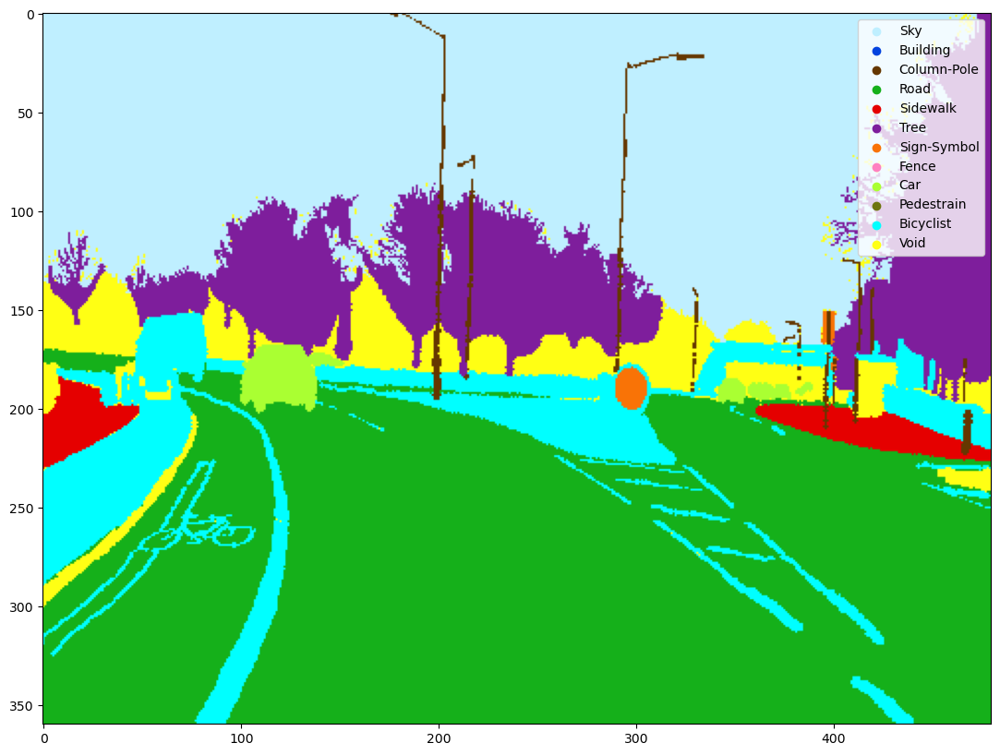

(360, 480) (360, 480)
Processing ID 288...
Showing random chosen crops:


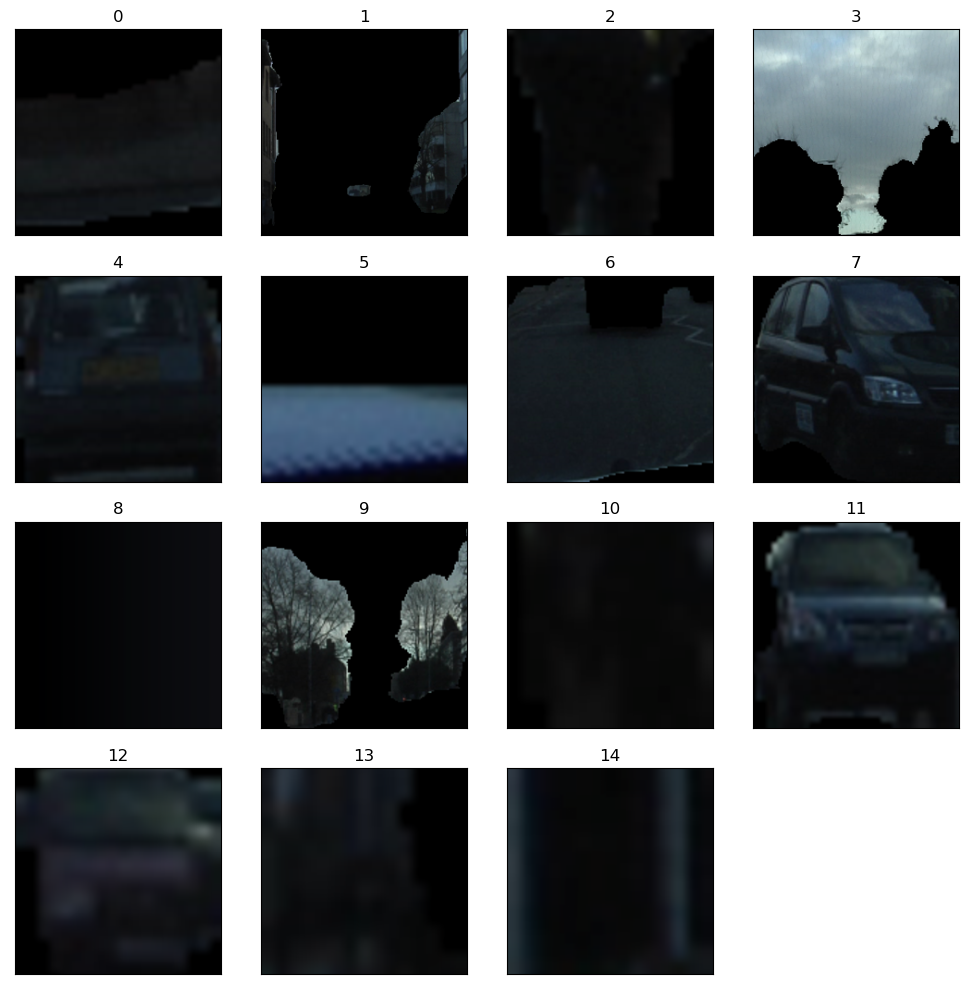

Image given as an input:


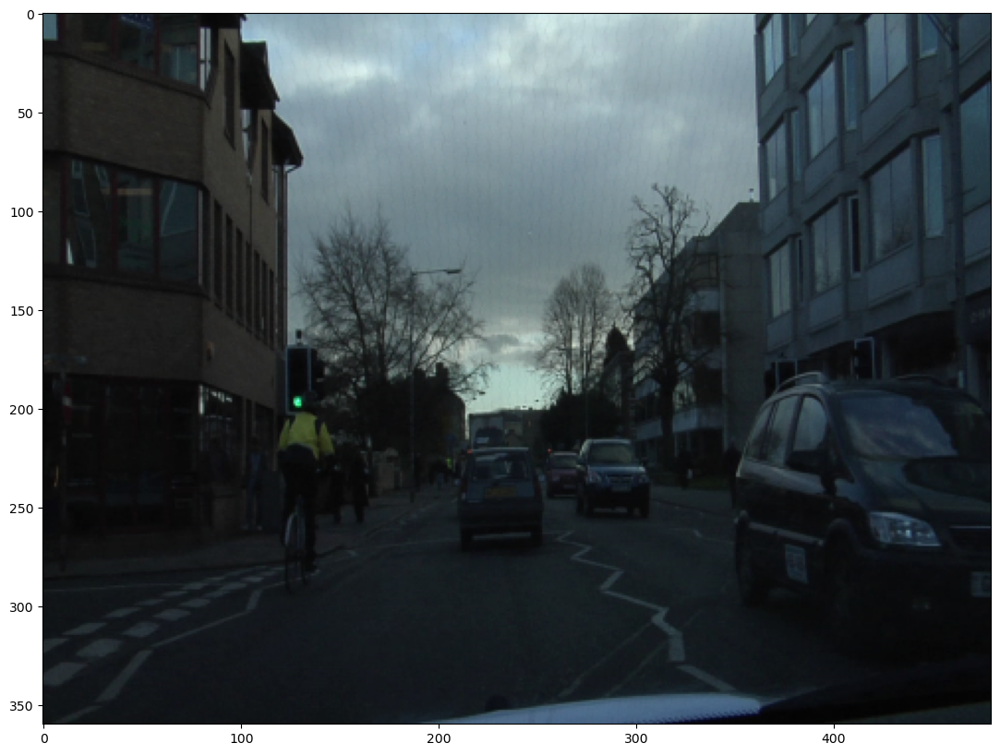

Prediction:


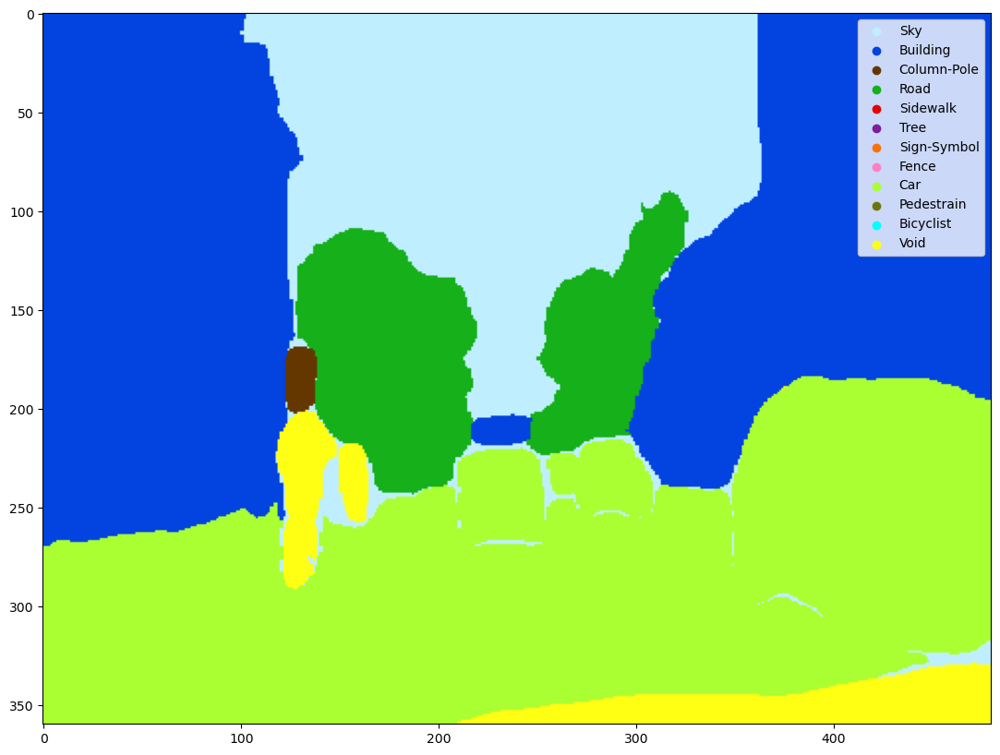

GT mask: 


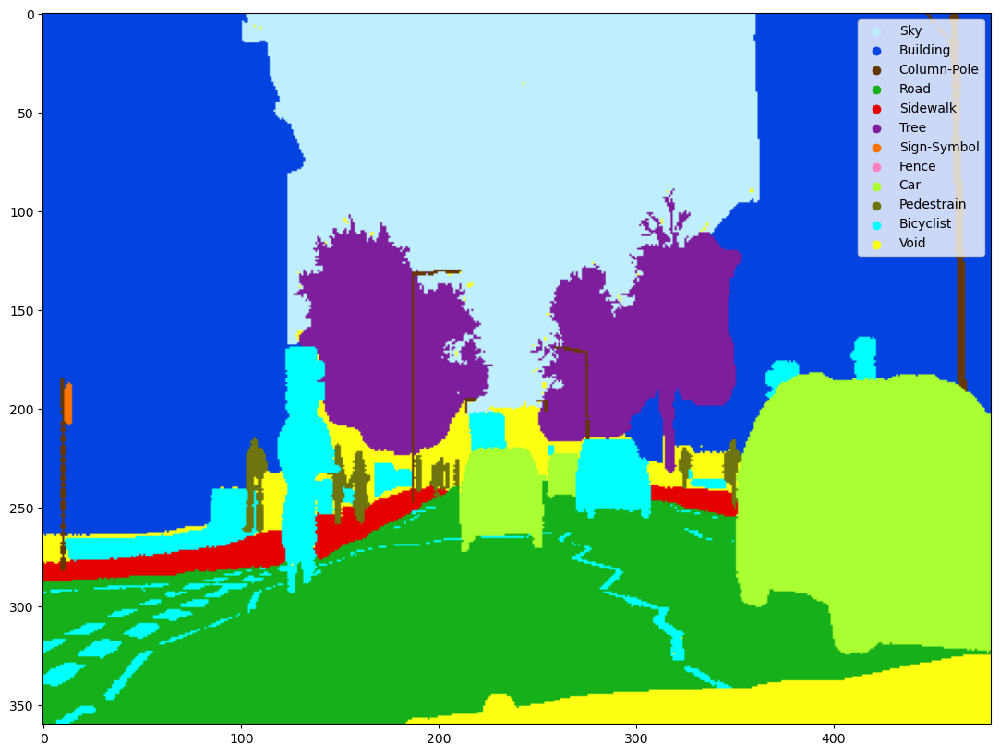

(360, 480) (360, 480)
Processing ID 255...
Showing random chosen crops:


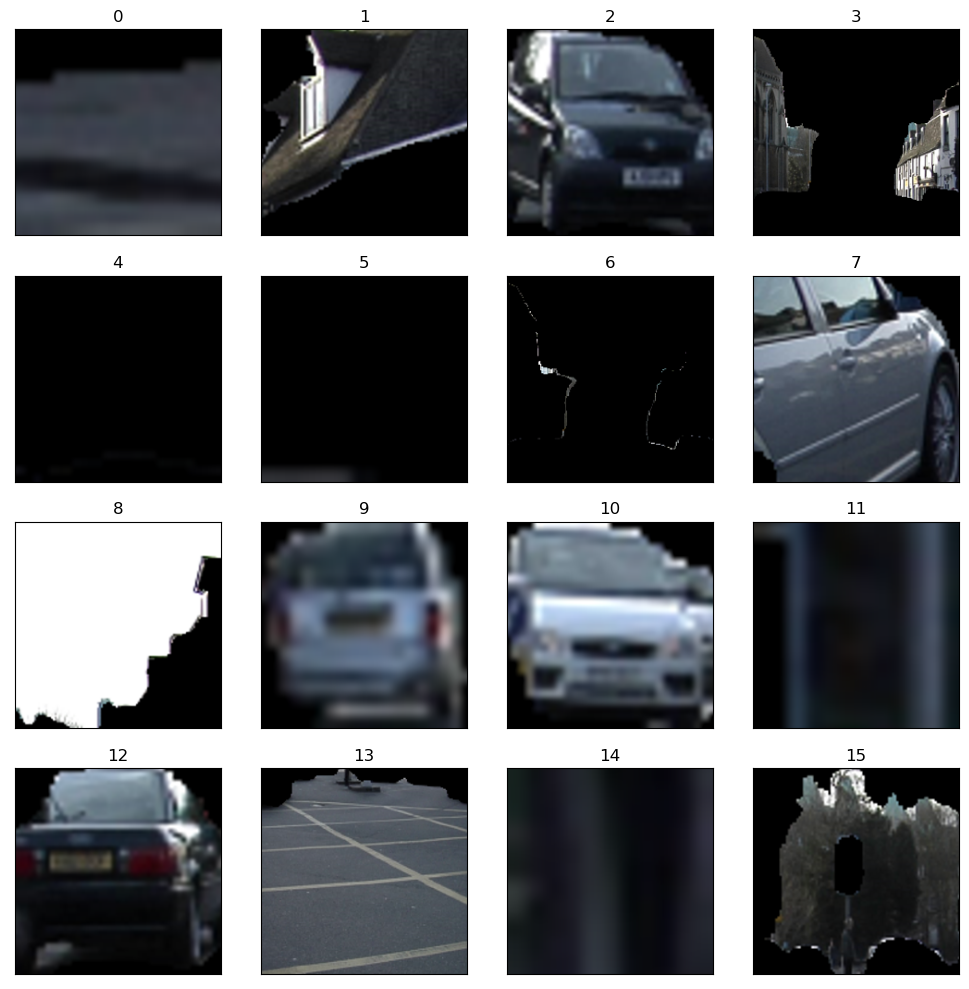

Image given as an input:


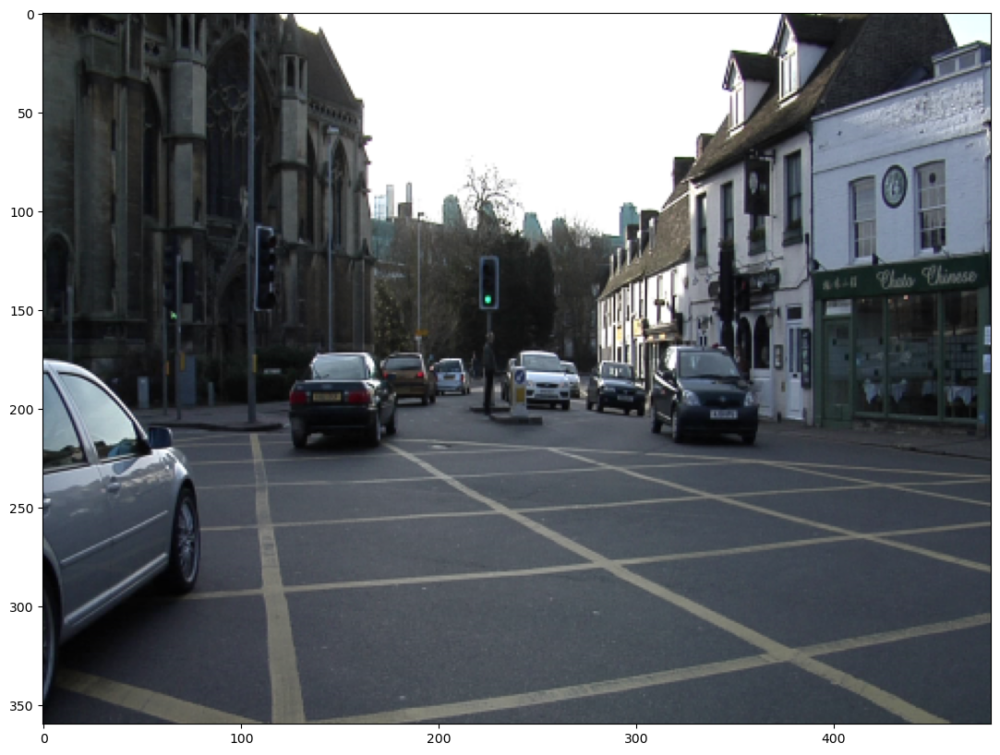

Prediction:


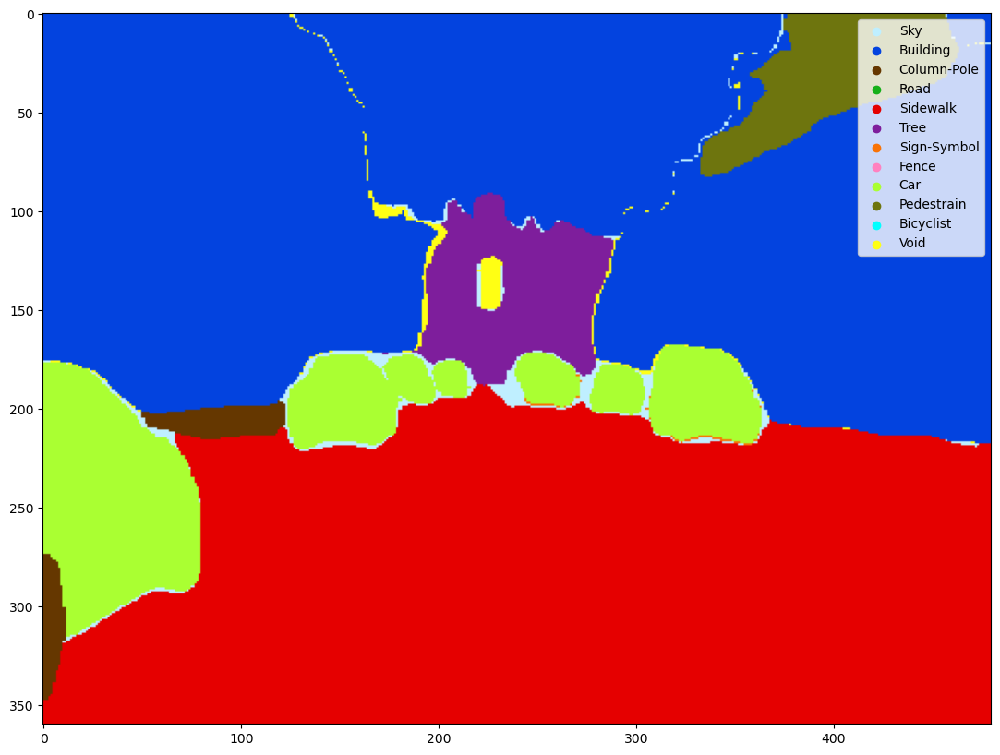

GT mask: 


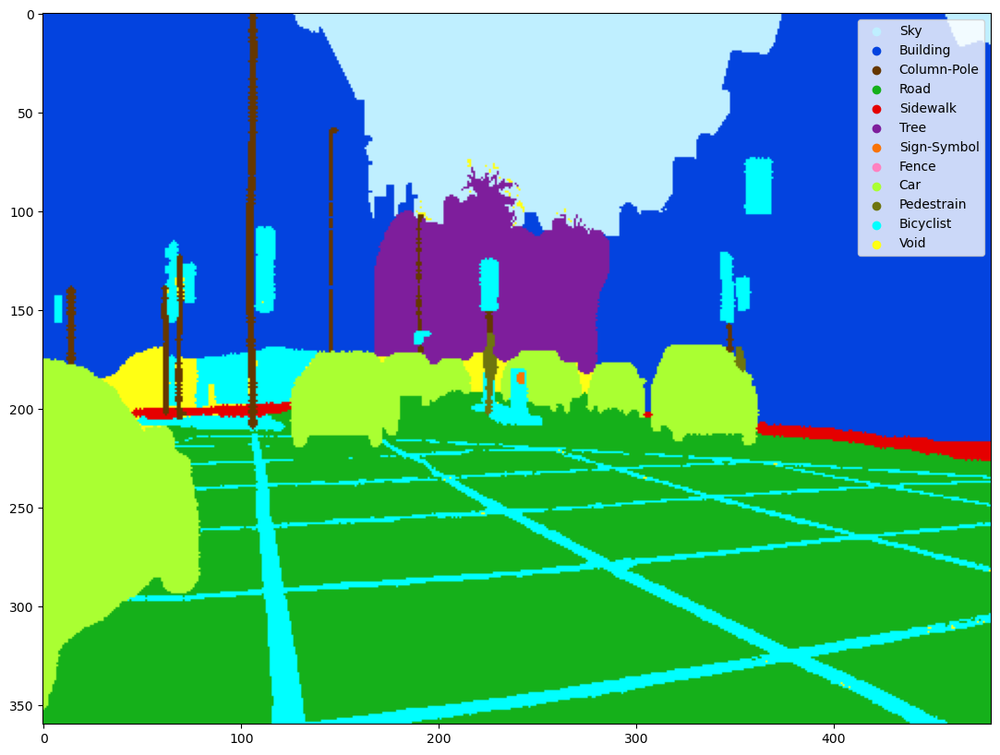

(360, 480) (360, 480)
Processing ID 144...
Showing random chosen crops:


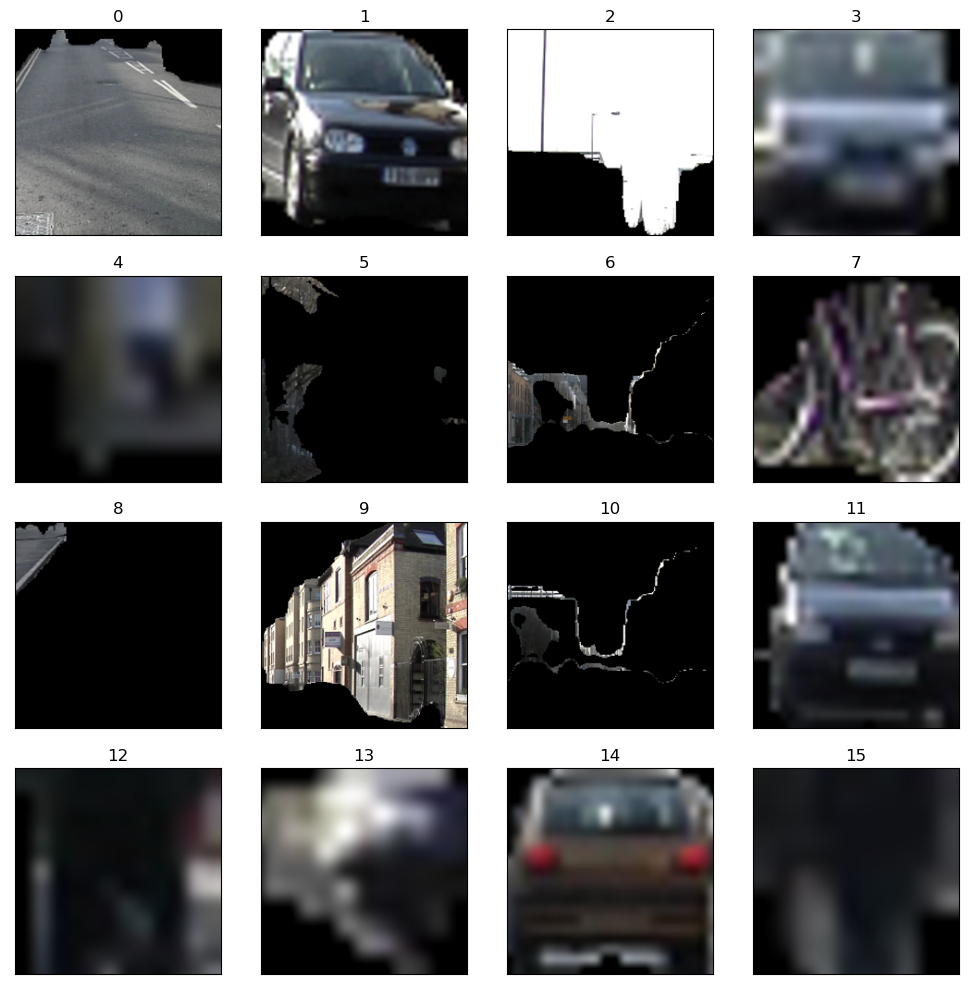

Image given as an input:


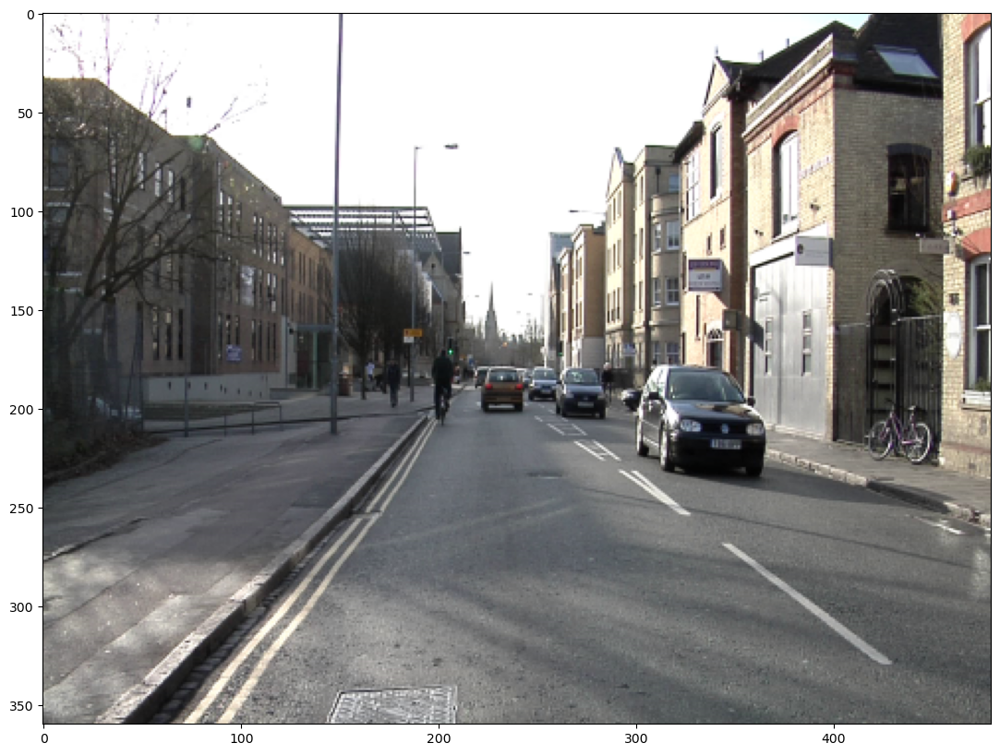

Prediction:


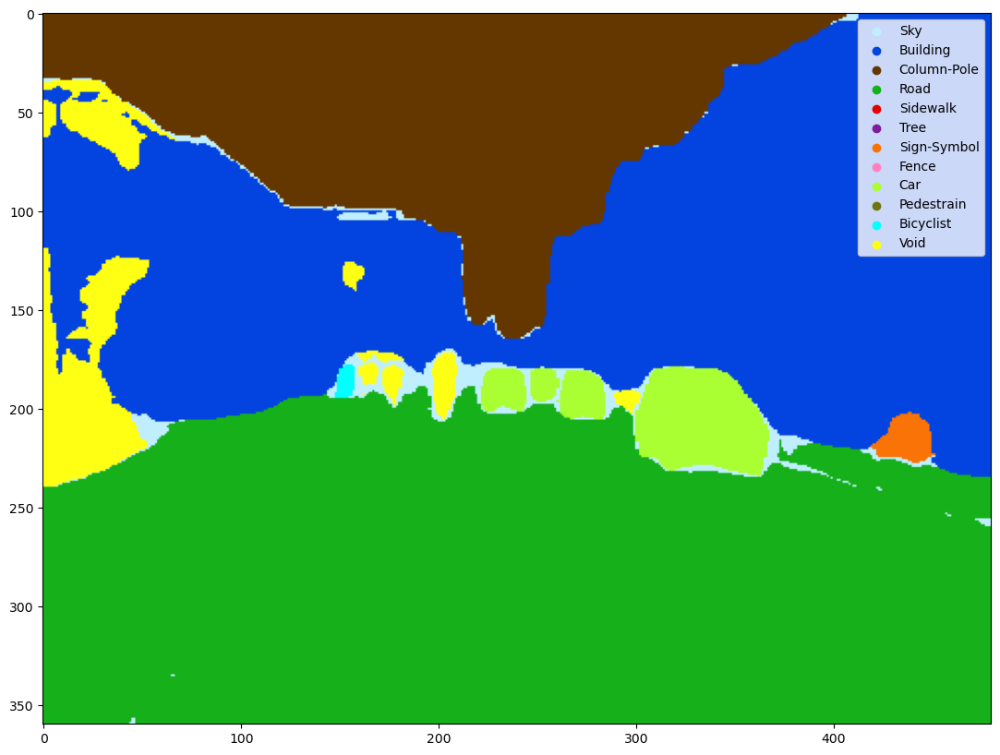

GT mask: 


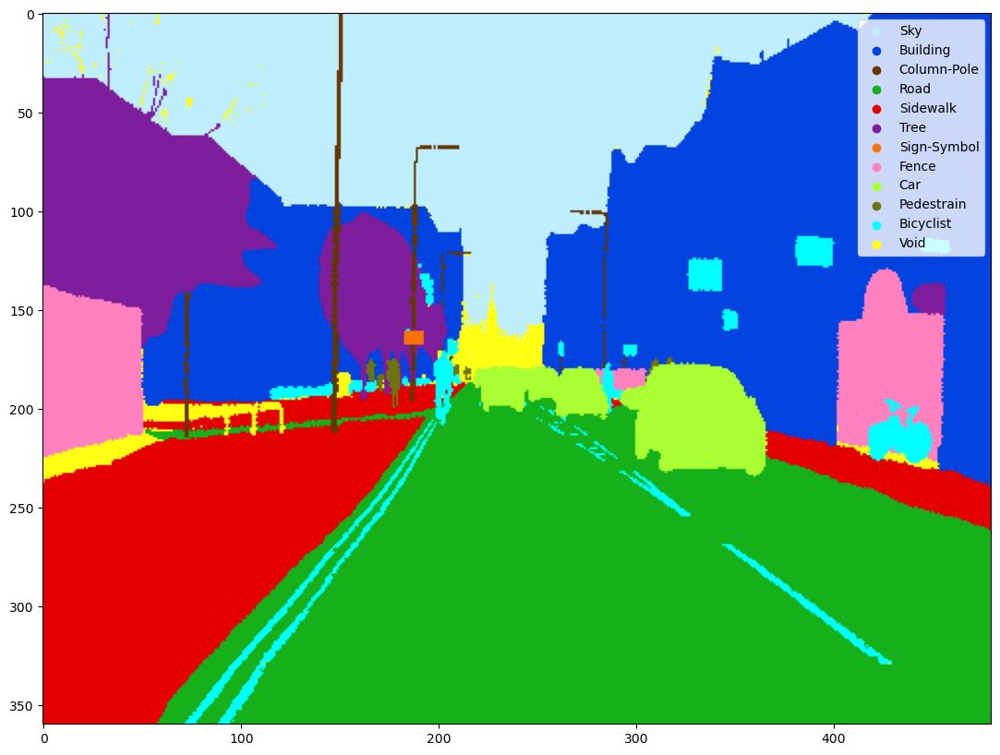

(360, 480) (360, 480)
Processing ID 86...
Showing random chosen crops:


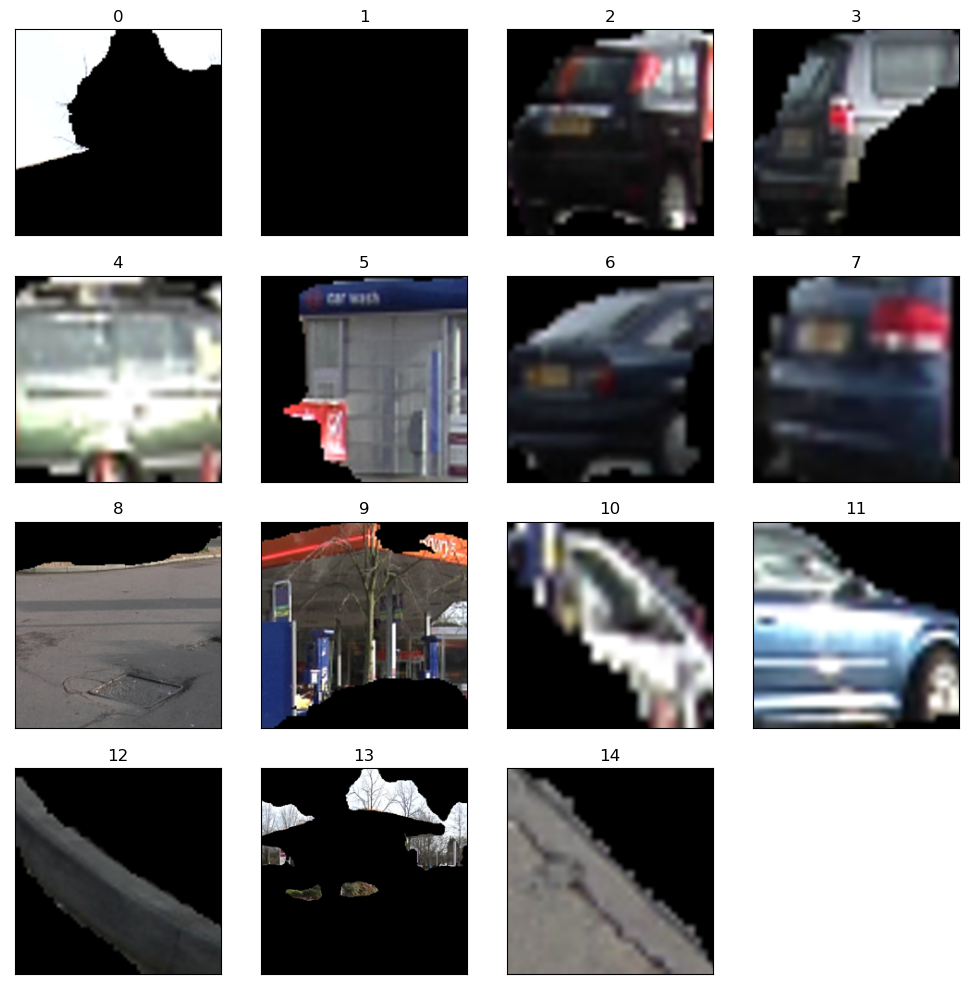

Image given as an input:


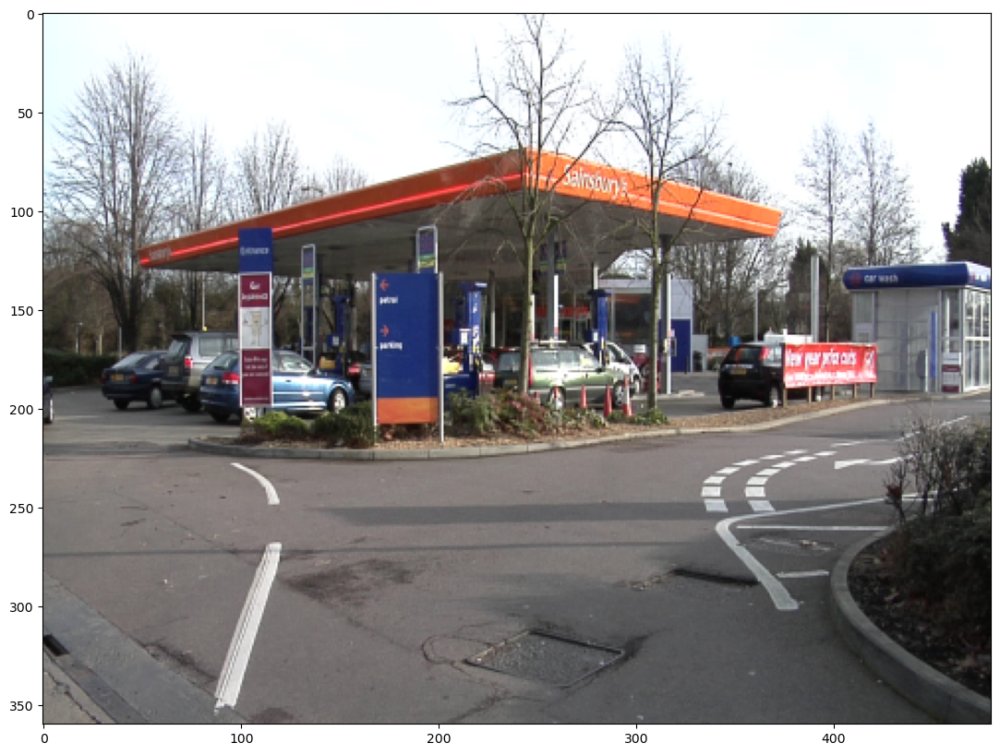

Prediction:


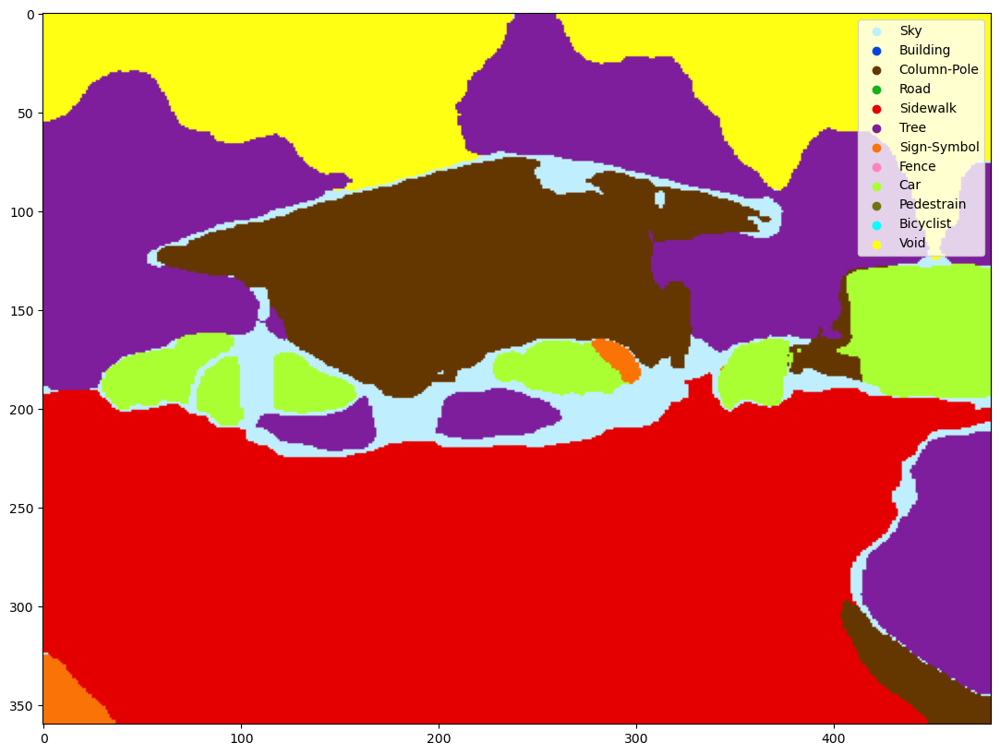

GT mask: 


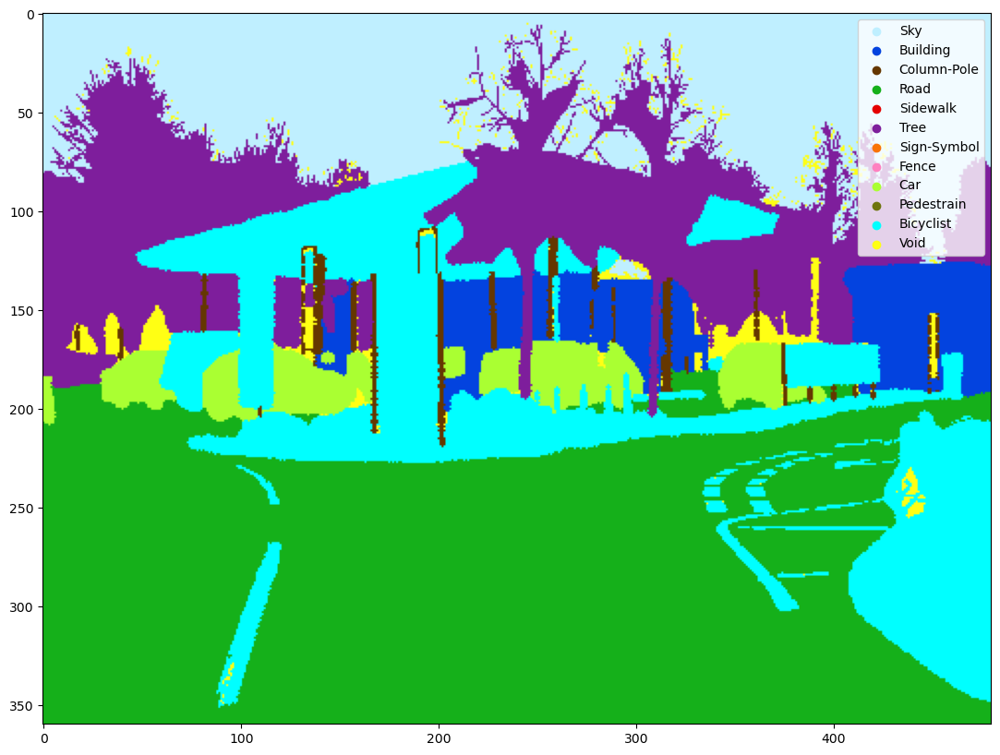

(360, 480) (360, 480)


In [15]:
import random

device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device, jit=False)
raw_image_transform = Compose()
d = CamVid(data_path, image_transform=preprocess, raw_image_transform = raw_image_transform)
n = len(d)
#Generate 5 random numbers between 10 and 30
preds = []
randomlist = random.sample(range(0, n), 10)
for _id in randomlist:
    print(f"Processing ID {_id}...")
    label, segm_mask = predict_segmentation_mask_masked(d, model, _id)
    preds.append({'id': _id, 'pred': segm_mask, 'gt': label})

In [47]:
from sklearn.metrics import f1_score, precision_score, recall_score, jaccard_score

def validate(pred_dict):
    metrics = []
    for sample in pred_dict:
        id_ = sample['id']
        pred, gt = sample['pred'], sample['gt']
        
        id_metrics = {'id': id_}
        
        for i, class_name in enumerate(CAMVID_CLASSES):
            id_metrics[class_name] = {
                'precision': precision_score((gt==i).flatten(), (pred==i).flatten()),
                'recall': recall_score((gt==i).flatten(), (pred==i).flatten()),
                'f1-score': f1_score((gt==i).flatten(), (pred==i).flatten()),
                'iou': jaccard_score((gt==i).flatten(), (pred==i).flatten()),
            }
        metrics.append(id_metrics)
    return metrics

In [48]:
metrics = validate(preds)

/Users/vlad/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/vlad/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/vlad/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/Users/vlad/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics

/Users/vlad/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/vlad/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/vlad/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/vlad/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification

/Users/vlad/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/vlad/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/vlad/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/Users/vlad/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics

In [51]:
for class_name in CAMVID_CLASSES:
    
    recall = np.array([sample[class_name]['recall'] for sample in metrics])
    f1 = np.array([sample[class_name]['f1-score'] for sample in metrics])
    precision = np.array([sample[class_name]['precision'] for sample in metrics])
    iou = np.array([sample[class_name]['iou'] for sample in metrics])
    
    print(f"Metrics for class {class_name}")
    print(f"IOU: Mean {iou.mean().round(2)}, Std {iou.std().round(2)}")
#     print(f"F1-score: Mean {f1.mean().round(2)}, Std {f1.std().round(2)}")
#     print(f"Recall: Mean {recall.mean().round(2)}, Std {recall.std().round(2)}")
#     print(f"Precision: Mean {precision.mean().round(2)}, Std {precision.std().round(2)}")
    print()
    

Metrics for class Sky
IOU: Mean 0.18, Std 0.35

Metrics for class Building
IOU: Mean 0.4, Std 0.36

Metrics for class Column-Pole
IOU: Mean 0.01, Std 0.02

Metrics for class Road
IOU: Mean 0.37, Std 0.39

Metrics for class Sidewalk
IOU: Mean 0.0, Std 0.01

Metrics for class Tree
IOU: Mean 0.32, Std 0.27

Metrics for class Sign-Symbol
IOU: Mean 0.0, Std 0.0

Metrics for class Fence
IOU: Mean 0.0, Std 0.0

Metrics for class Car
IOU: Mean 0.4, Std 0.28

Metrics for class Pedestrain
IOU: Mean 0.0, Std 0.0

Metrics for class Bicyclist
IOU: Mean 0.0, Std 0.0

Metrics for class Void
IOU: Mean 0.11, Std 0.18



In [40]:
metrics[0]

{'id': 202,
 'Sky': {'precision': 0.035800970873786406,
  'recall': 0.005232661266481405,
  'f1-score': 0.009130771214856849},
 'Building': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0},
 'Column-Pole': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0},
 'Road': {'precision': 0.5695509309967142,
  'recall': 0.9990159786326789,
  'f1-score': 0.7254908633069045},
 'Sidewalk': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0},
 'Tree': {'precision': 0.6861313868613139,
  'recall': 0.952199263777306,
  'f1-score': 0.7975603717957374},
 'Sign-Symbol': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0},
 'Fence': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0},
 'Car': {'precision': 0.009215302987992181,
  'recall': 0.11870503597122302,
  'f1-score': 0.017102876392847886},
 'Pedestrain': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0},
 'Bicyclist': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0},
 'Void': {'precision': 0.04892966360856269,
  'recall': 0.0037638202775817455,
